<h2 style="color:#f450ff">MACHINE LEARNING MODELS TO PREDICT THE NEXT DAY MAXIMUM AND MINIMUM TEMPERATURE</h2>

In [1]:
#Importing the necessary libraries

In [2]:
import numpy as np
import pandas as pd

In [3]:
import matplotlib.pyplot as plt
%matplotlib inline

In [4]:
import seaborn as sns

<h2>IMPORTING THE DATASET</h2>

In [5]:
df = pd.read_csv('temperature.csv')
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In [6]:
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


In [8]:
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7750.000000,7682.000000,7682.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,...,7677.000000,7677.000000,7677.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7725.000000,7725.000000
mean,13.000000,29.768211,23.225059,56.759372,88.374804,29.613447,23.512589,7.097875,62.505019,0.368774,...,0.485003,0.278200,0.269407,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220
std,7.211568,2.969999,2.413961,14.668111,7.192004,2.947191,2.345347,2.183836,33.730589,0.262458,...,1.762807,1.161809,1.206214,0.050352,0.079435,54.279780,1.370444,429.158867,3.128010,2.487613
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,...,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.700000,45.963543,84.222862,27.673499,22.089739,5.678705,37.266753,0.146654,...,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000
50%,13.000000,29.900000,23.400000,55.039024,89.793480,29.703426,23.760199,6.547470,56.865482,0.315697,...,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.900000,67.190056,93.743629,31.710450,25.152909,8.032276,84.223616,0.575489,...,0.018364,0.007896,0.000041,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,...,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


<h2>EXPLORATORY DATA ANALYSIS</h2>

In [9]:
#Checking null values
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

In [10]:
#There are 75 null values in 80% of the columns in the dataset

In [11]:
#Checking duplicates
df.duplicated().sum()

0

In [12]:
#We don't have any duplicate samples in the dataset

<h2>DATA VISUALIZATION</h2>

<Axes: xlabel='Next_Tmax', ylabel='Density'>

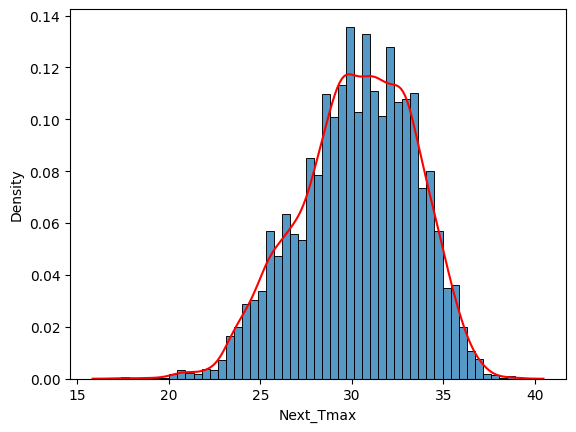

In [13]:
sns.histplot(data=df, x='Next_Tmax', stat='density')
sns.kdeplot(data=df, x='Next_Tmax', color='red')

<Axes: xlabel='Next_Tmin', ylabel='Density'>

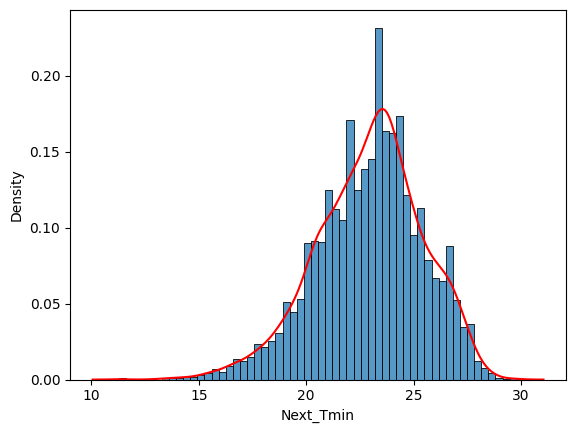

In [14]:
sns.histplot(data=df, x='Next_Tmin', stat='density')
sns.kdeplot(data=df, x='Next_Tmin', color='red')

In [15]:
import warnings
warnings.filterwarnings(action='ignore')

In [16]:
#Converting date column from object to DateTime format
df['Date'] = df['Date'].astype('datetime64[ns]')
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,2017-08-30,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,2017-08-30,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,2017-08-30,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaT,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   station           7750 non-null   float64       
 1   Date              7750 non-null   datetime64[ns]
 2   Present_Tmax      7682 non-null   float64       
 3   Present_Tmin      7682 non-null   float64       
 4   LDAPS_RHmin       7677 non-null   float64       
 5   LDAPS_RHmax       7677 non-null   float64       
 6   LDAPS_Tmax_lapse  7677 non-null   float64       
 7   LDAPS_Tmin_lapse  7677 non-null   float64       
 8   LDAPS_WS          7677 non-null   float64       
 9   LDAPS_LH          7677 non-null   float64       
 10  LDAPS_CC1         7677 non-null   float64       
 11  LDAPS_CC2         7677 non-null   float64       
 12  LDAPS_CC3         7677 non-null   float64       
 13  LDAPS_CC4         7677 non-null   float64       
 14  LDAPS_PPT1        7677 n

<Axes: xlabel='Present_Tmax', ylabel='Density'>

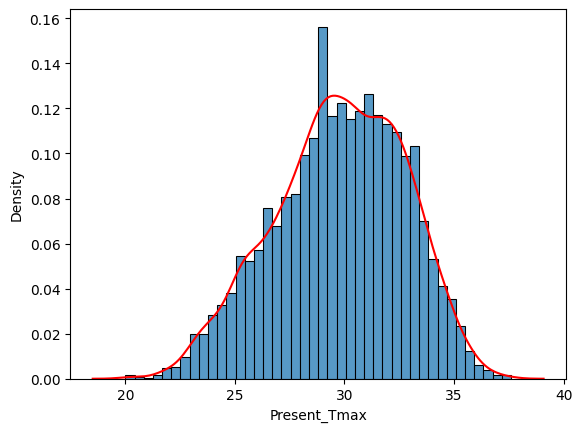

In [18]:
sns.histplot(data=df, x='Present_Tmax', stat='density')
sns.kdeplot(data=df, x='Present_Tmax', color='red')

<Axes: xlabel='Present_Tmin', ylabel='Density'>

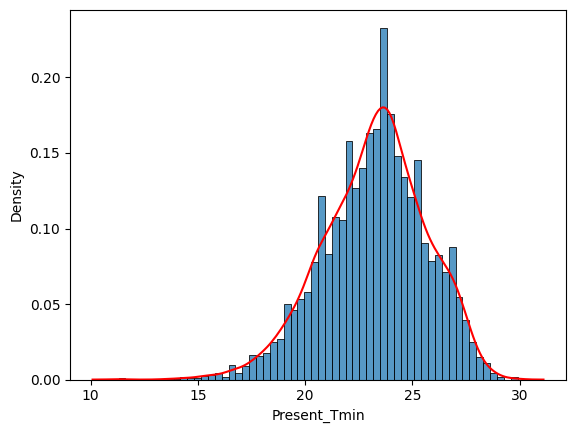

In [19]:
sns.histplot(data=df, x='Present_Tmin', stat='density')
sns.kdeplot(data=df, x='Present_Tmin', color='red')

In [20]:
#LINEPLOTS

In [21]:
import plotly.express as px

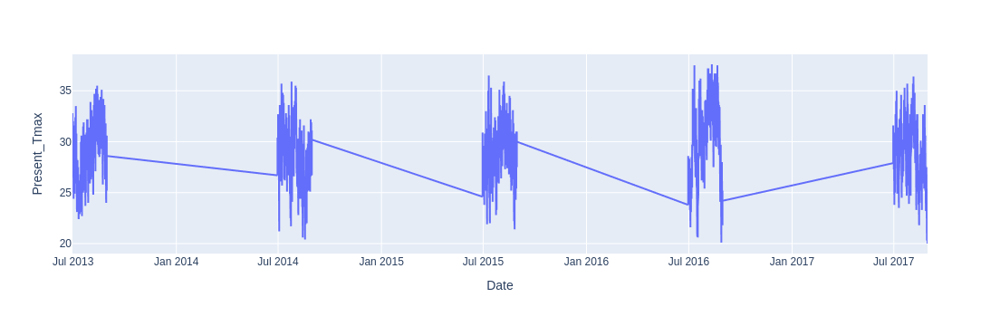

<Figure size 2000x1000 with 0 Axes>

In [22]:
plt.figure(figsize=(20,10))
px.line(data_frame=df,x='Date', y='Present_Tmax')

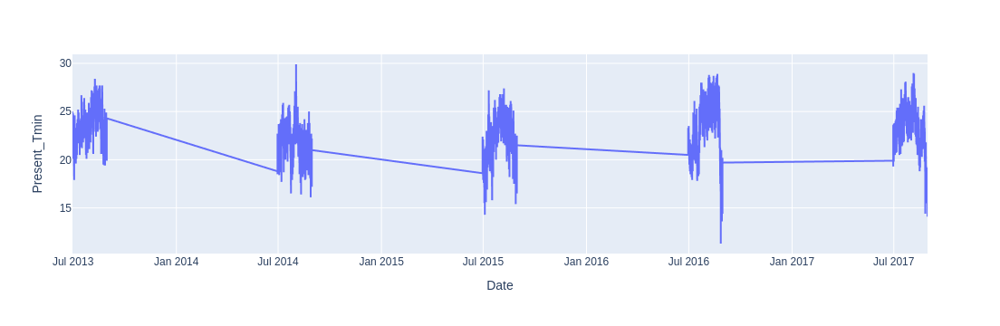

In [23]:
px.line(data_frame=df, x='Date', y='Present_Tmin')

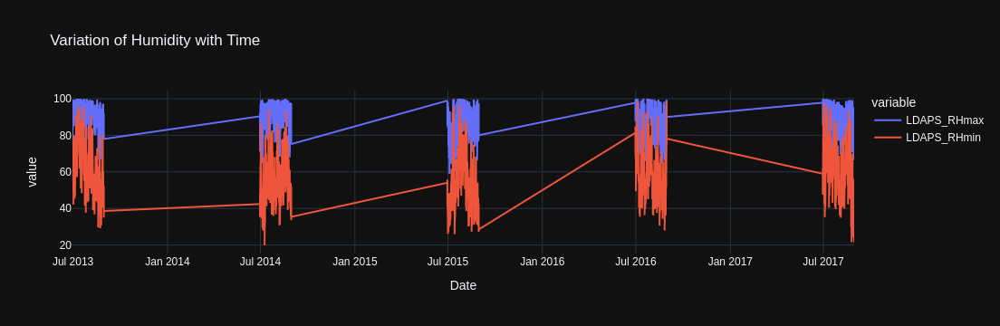

<Figure size 2000x2000 with 0 Axes>

In [24]:
plt.figure(figsize=(20,20))
px.line(data_frame=df,x = 'Date', y = ['LDAPS_RHmax', 'LDAPS_RHmin'], template = 'plotly_dark', title = 'Variation of Humidity with Time')

In [25]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

<Axes: xlabel='lon', ylabel='lat'>

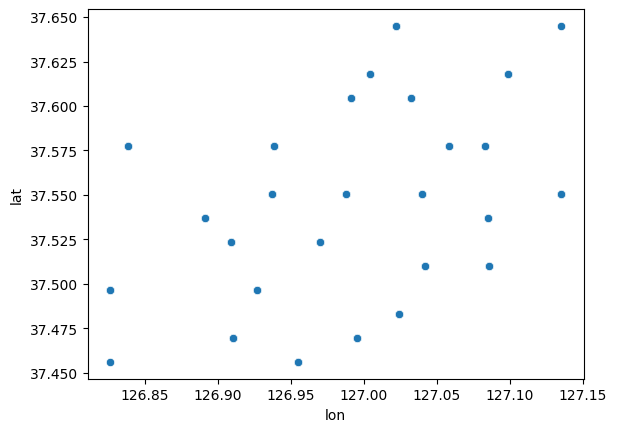

In [26]:
sns.scatterplot(data=df, y='lat', x='lon')

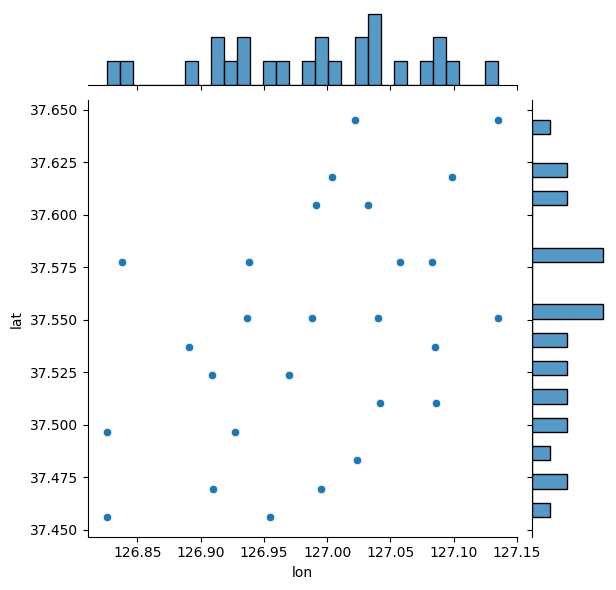

In [27]:
sns.jointplot(data=df, x='lon', y='lat')

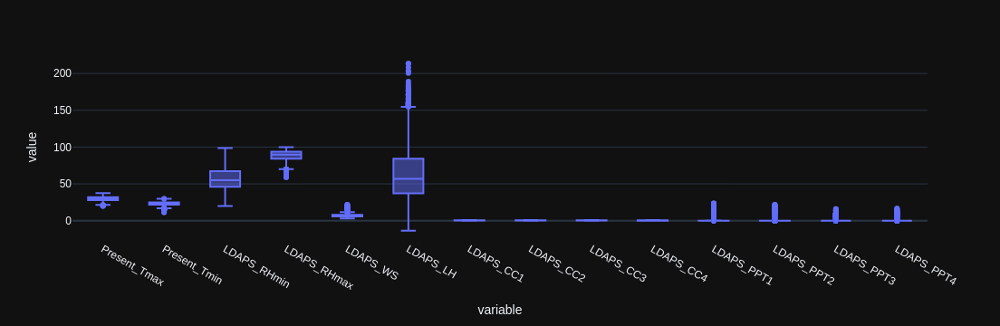

In [28]:
px.box(data_frame=df, y=['Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax', 
       'LDAPS_WS', 'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1', 
        'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4',] ,template = 'plotly_dark')

<p style="font-size:120%;color:purple">We can see that there are some outliers in our data</p>

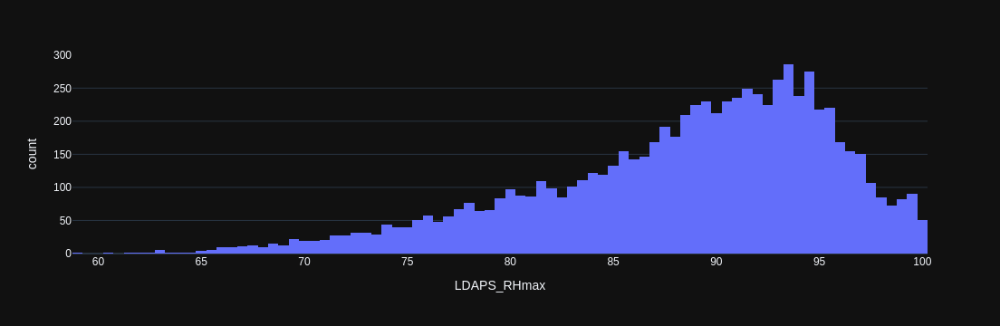

In [29]:
px.histogram(data_frame=df, x='LDAPS_RHmax',template = 'plotly_dark')

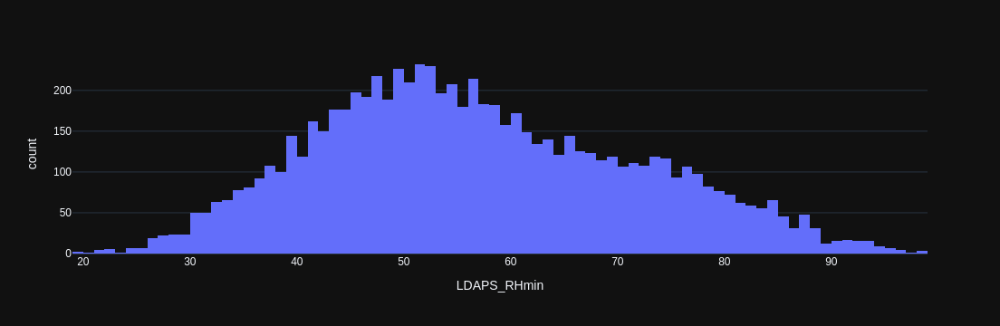

In [30]:
px.histogram(data_frame=df, x='LDAPS_RHmin',template = 'plotly_dark')

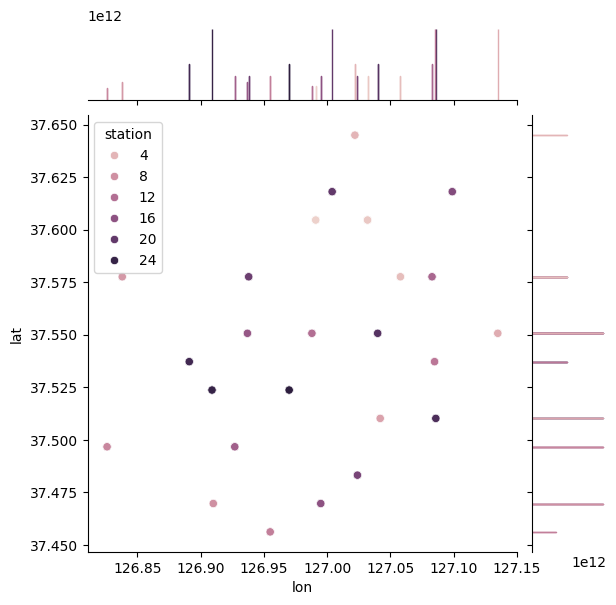

In [31]:
sns.jointplot(data=df, x='lon', y='lat',hue='station')

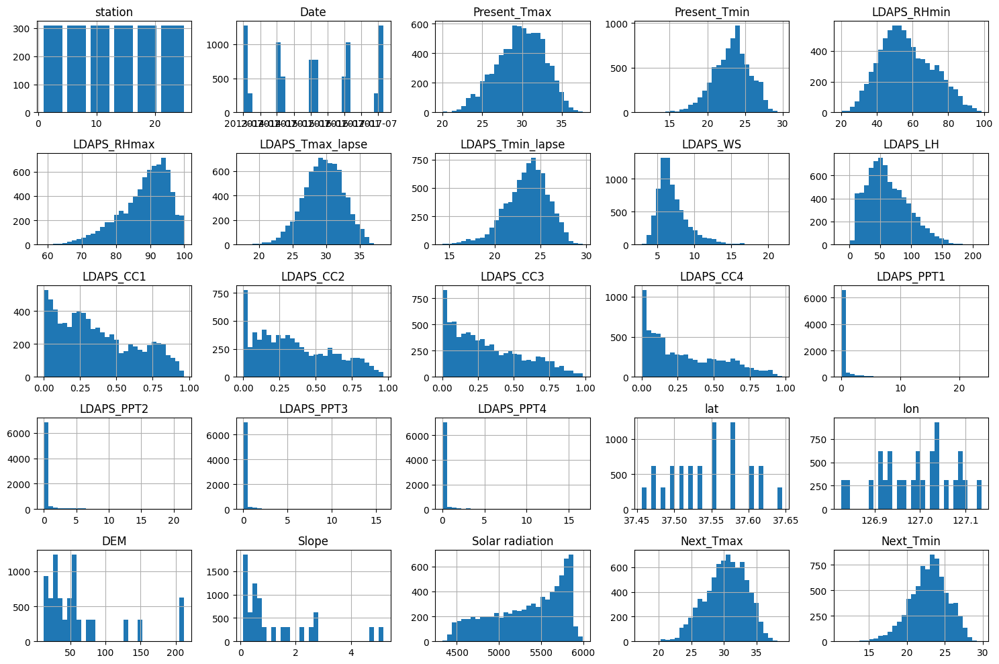

In [32]:
df.hist(bins=30, figsize=(15,10))
plt.tight_layout()

In [33]:
df.tail()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
7747,23.0,2017-08-30,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,2017-08-30,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,2017-08-30,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaT,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3
7751,NaN,NaT,37.6,29.9,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,...,21.621661,15.841235,16.655469,37.6450,127.135,212.3350,5.178230,5992.895996,38.9,29.8


In [34]:
df.iloc[7751]

station                     NaN
Date                        NaT
Present_Tmax               37.6
Present_Tmin               29.9
LDAPS_RHmin           98.524734
LDAPS_RHmax          100.000153
LDAPS_Tmax_lapse      38.542255
LDAPS_Tmin_lapse      29.619342
LDAPS_WS              21.857621
LDAPS_LH             213.414006
LDAPS_CC1              0.967277
LDAPS_CC2              0.968353
LDAPS_CC3              0.983789
LDAPS_CC4               0.97471
LDAPS_PPT1            23.701544
LDAPS_PPT2            21.621661
LDAPS_PPT3            15.841235
LDAPS_PPT4            16.655469
lat                      37.645
lon                     127.135
DEM                     212.335
Slope                   5.17823
Solar radiation     5992.895996
Next_Tmax                  38.9
Next_Tmin                  29.8
Name: 7751, dtype: object

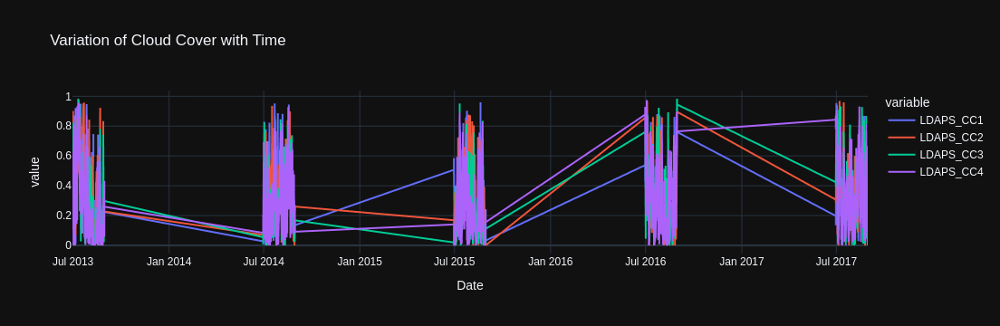

In [35]:
px.line(data_frame=df,x = 'Date', y = ['LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4'], template = 'plotly_dark', title = 'Variation of Cloud Cover with Time')

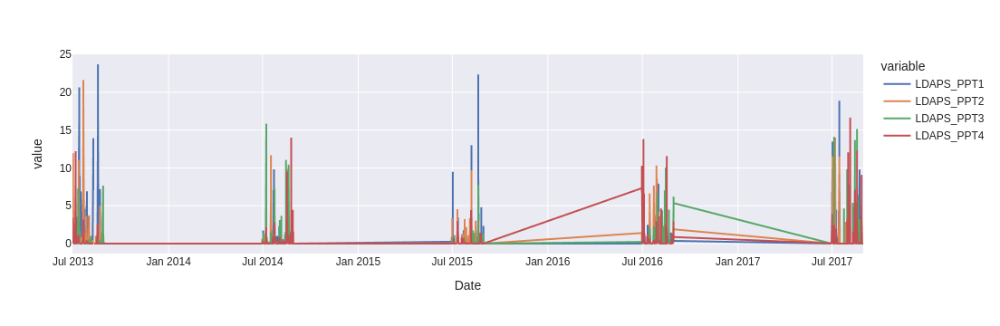

In [36]:
px.line(data_frame=df, x='Date', y=['LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4'],template='seaborn')

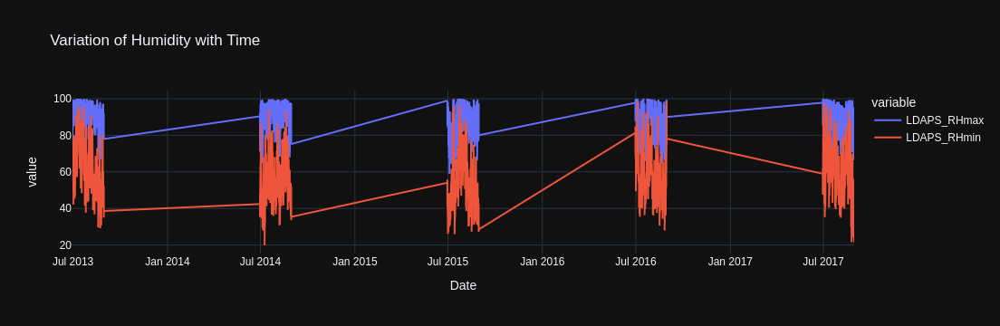

In [37]:
px.line(data_frame=df,x = 'Date', y = ['LDAPS_RHmax', 'LDAPS_RHmin'], template = 'plotly_dark', title = 'Variation of Humidity with Time')

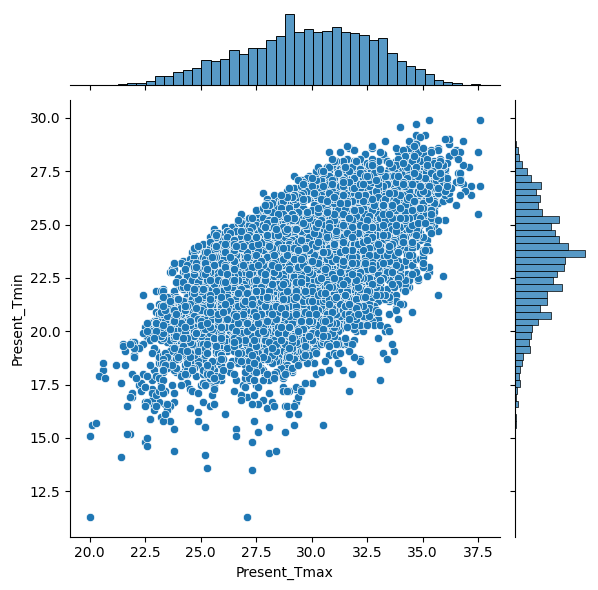

In [38]:
sns.jointplot(data=df, x='Present_Tmax', y='Present_Tmin')

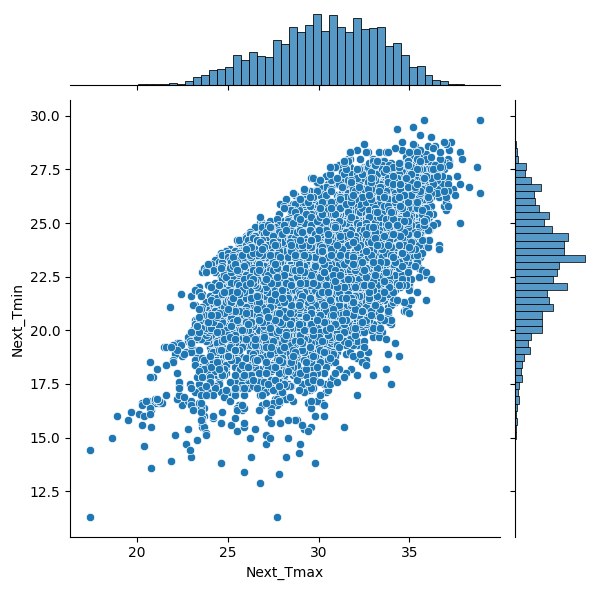

In [39]:
sns.jointplot(data=df, x='Next_Tmax', y='Next_Tmin')

<h2>SEABORN HEATMAP</h2>

In [40]:
df.corr()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
station,1.000000e+00,1.063442e-15,0.113211,0.132419,-0.067122,-0.168010,0.069561,0.105422,0.005320,-0.134226,...,-0.008369,-0.012671,-0.010580,-0.237610,-0.118763,-0.255970,-0.090113,-0.019011,0.108306,0.128719
Date,1.063442e-15,1.000000e+00,0.020746,0.026687,-0.004848,-0.017434,0.012284,0.008710,-0.066885,-0.002487,...,-0.103249,-0.090501,-0.095373,-0.001815,0.002133,-0.014459,-0.015669,-0.003945,0.026018,0.020487
Present_Tmax,1.132114e-01,2.074597e-02,1.000000,0.618760,-0.206782,-0.304209,0.575289,0.629247,-0.122876,0.136716,...,-0.100420,-0.121271,-0.101471,-0.052776,0.009075,-0.187855,-0.106097,-0.025557,0.613109,0.625252
Present_Tmin,1.324190e-01,2.668701e-02,0.618760,1.000000,0.124921,-0.015334,0.470118,0.772921,-0.035111,-0.009368,...,0.069095,-0.046645,-0.064394,-0.078715,-0.043725,-0.251257,-0.146736,0.053828,0.473868,0.799758
LDAPS_RHmin,-6.712167e-02,-4.848367e-03,-0.206782,0.124921,1.000000,0.579141,-0.564580,0.089476,0.294361,-0.070858,...,0.390967,0.240642,0.168595,0.087523,-0.076608,0.102612,0.124346,0.244795,-0.442958,0.095830
LDAPS_RHmax,-1.680105e-01,-1.743374e-02,-0.304209,-0.015334,0.579141,1.000000,-0.373404,-0.114143,0.135333,0.238579,...,0.229050,0.134607,0.117853,0.196751,0.025792,0.178031,0.220668,0.149699,-0.286478,-0.072490
LDAPS_Tmax_lapse,6.956068e-02,1.228365e-02,0.575289,0.470118,-0.564580,-0.373404,1.000000,0.654021,-0.311996,0.048010,...,-0.242122,-0.188115,-0.160273,-0.042298,0.091107,-0.179766,-0.163123,0.048111,0.836144,0.591535
LDAPS_Tmin_lapse,1.054220e-01,8.709762e-03,0.629247,0.772921,0.089476,-0.114143,0.654021,1.000000,-0.130035,-0.134761,...,0.000870,-0.088575,-0.094655,-0.096726,-0.026831,-0.196407,-0.186753,0.160443,0.593195,0.886964
LDAPS_WS,5.319869e-03,-6.688528e-02,-0.122876,-0.035111,0.294361,0.135333,-0.311996,-0.130035,1.000000,0.006711,...,0.191886,0.161684,0.144085,0.036836,-0.059756,0.191983,0.172464,0.122116,-0.346592,-0.097390
LDAPS_LH,-1.342263e-01,-2.486897e-03,0.136716,-0.009368,-0.070858,0.238579,0.048010,-0.134761,0.006711,1.000000,...,-0.077545,0.016102,0.019979,0.133870,0.025948,0.055402,0.087203,-0.047523,0.159324,-0.055895


<Axes: >

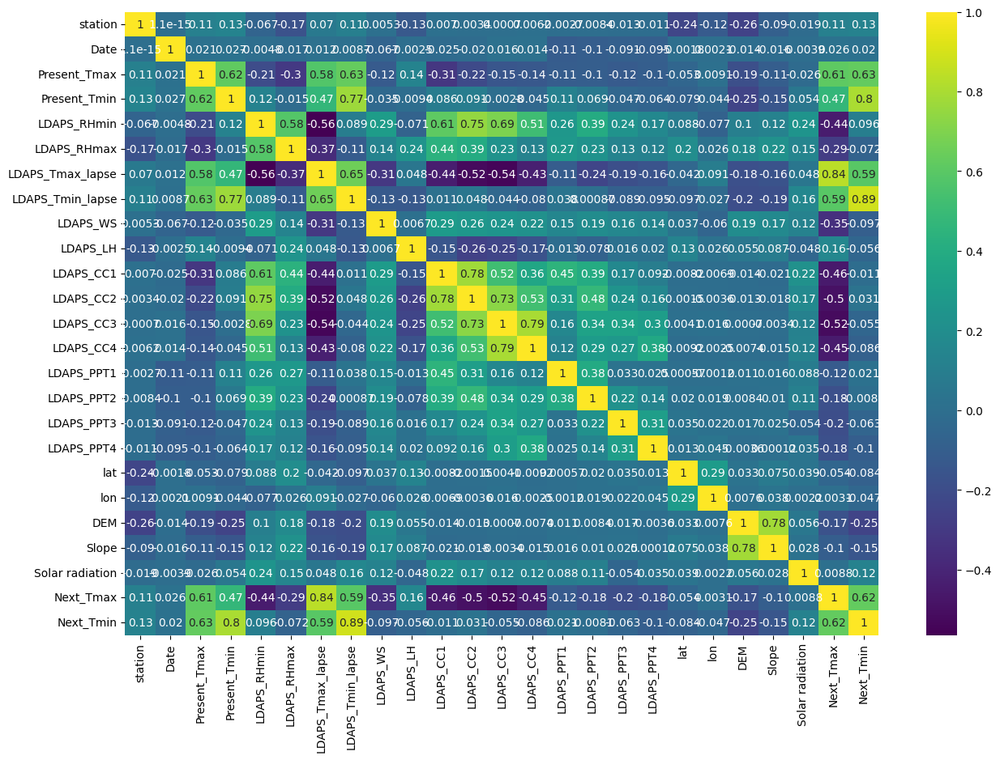

In [41]:
plt.figure(figsize=(15,10))
sns.heatmap(data=df.corr(), annot=True, cmap='viridis')

<h2>FEATURE ENGINEERING</h2>

In [42]:
df['year'] = df['Date'].apply(lambda x: x.year)
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2,2013.0
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5,2013.0
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9,2013.0
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3,2013.0
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5,2013.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,2017-08-30,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1,2017.0
7748,24.0,2017-08-30,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8,2017.0
7749,25.0,2017-08-30,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4,2017.0
7750,NaN,NaT,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3,NaN


In [43]:
df['month'] = df['Date'].apply(lambda x: x.month)
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year,month
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2,2013.0,6.0
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5,2013.0,6.0
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9,2013.0,6.0
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3,2013.0,6.0
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5,2013.0,6.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,2017-08-30,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1,2017.0,8.0
7748,24.0,2017-08-30,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8,2017.0,8.0
7749,25.0,2017-08-30,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4,2017.0,8.0
7750,NaN,NaT,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3,NaN,NaN


In [44]:
df.drop('Date', axis=1)
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year,month
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2,2013.0,6.0
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5,2013.0,6.0
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9,2013.0,6.0
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3,2013.0,6.0
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5,2013.0,6.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,2017-08-30,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1,2017.0,8.0
7748,24.0,2017-08-30,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8,2017.0,8.0
7749,25.0,2017-08-30,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4,2017.0,8.0
7750,NaN,NaT,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3,NaN,NaN


In [45]:
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
year                 2
month                2
dtype: int64

In [46]:
#We will drop all null values as there are very few samples of null values and the dataset is quite large

In [47]:
df.dropna(axis=0, inplace=True)

In [48]:
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year,month
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,2013.0,6.0
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,2013.0,6.0
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,2013.0,6.0
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,2013.0,6.0
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,2013.0,6.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,21.0,2017-08-30,23.1,17.8,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,...,0.0,37.5507,127.040,26.2980,0.5721,4456.024414,27.6,17.7,2017.0,8.0
7746,22.0,2017-08-30,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,...,0.0,37.5102,127.086,21.9668,0.1332,4441.803711,28.0,17.1,2017.0,8.0
7747,23.0,2017-08-30,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.0,37.5372,126.891,15.5876,0.1554,4443.313965,28.3,18.1,2017.0,8.0
7748,24.0,2017-08-30,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.0,37.5237,126.909,17.2956,0.2223,4438.373535,28.6,18.8,2017.0,8.0


In [49]:
df['year'] = df['year'].astype('int')
df['month'] = df['month'].astype('int')
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year,month
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,2013,6
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,2013,6
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,2013,6
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,2013,6
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,2013,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,21.0,2017-08-30,23.1,17.8,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,...,0.0,37.5507,127.040,26.2980,0.5721,4456.024414,27.6,17.7,2017,8
7746,22.0,2017-08-30,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,...,0.0,37.5102,127.086,21.9668,0.1332,4441.803711,28.0,17.1,2017,8
7747,23.0,2017-08-30,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.0,37.5372,126.891,15.5876,0.1554,4443.313965,28.3,18.1,2017,8
7748,24.0,2017-08-30,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.0,37.5237,126.909,17.2956,0.2223,4438.373535,28.6,18.8,2017,8


In [50]:
df['station'] = df['station'].astype('int')
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year,month
0,1,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,2013,6
1,2,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,2013,6
2,3,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,2013,6
3,4,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,2013,6
4,5,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,2013,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,21,2017-08-30,23.1,17.8,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,...,0.0,37.5507,127.040,26.2980,0.5721,4456.024414,27.6,17.7,2017,8
7746,22,2017-08-30,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,...,0.0,37.5102,127.086,21.9668,0.1332,4441.803711,28.0,17.1,2017,8
7747,23,2017-08-30,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.0,37.5372,126.891,15.5876,0.1554,4443.313965,28.3,18.1,2017,8
7748,24,2017-08-30,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.0,37.5237,126.909,17.2956,0.2223,4438.373535,28.6,18.8,2017,8


In [51]:
df.drop_duplicates(inplace=True)
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year,month
0,1,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,2013,6
1,2,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,2013,6
2,3,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,2013,6
3,4,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,2013,6
4,5,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,2013,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,21,2017-08-30,23.1,17.8,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,...,0.0,37.5507,127.040,26.2980,0.5721,4456.024414,27.6,17.7,2017,8
7746,22,2017-08-30,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,...,0.0,37.5102,127.086,21.9668,0.1332,4441.803711,28.0,17.1,2017,8
7747,23,2017-08-30,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.0,37.5372,126.891,15.5876,0.1554,4443.313965,28.3,18.1,2017,8
7748,24,2017-08-30,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.0,37.5237,126.909,17.2956,0.2223,4438.373535,28.6,18.8,2017,8


<h2>DATA VISUALIZATION</h2>

Text(0.5, 1.0, 'MEAN PRESENT MAX TEMP BY YEAR')

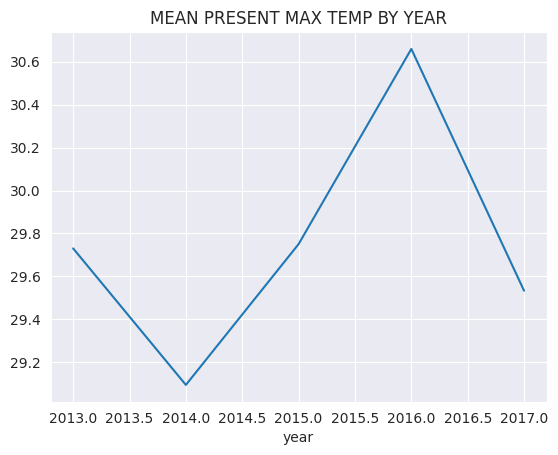

In [52]:
sns.set_style('darkgrid')
df.groupby(by='year')['Present_Tmax'].mean().plot.line()
plt.title('MEAN PRESENT MAX TEMP BY YEAR')

Text(0.5, 1.0, 'MEAN PRESENT MIN TEMP BY YEAR')

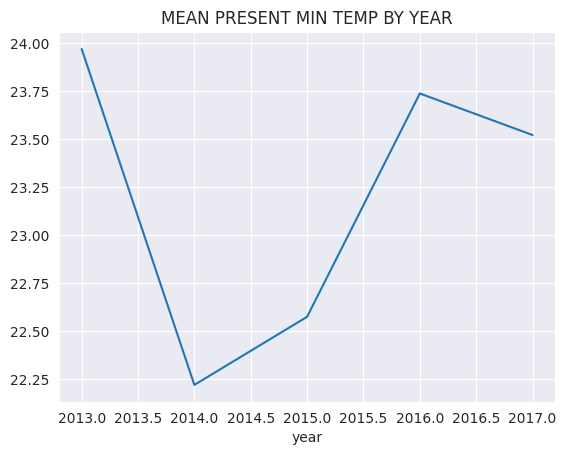

In [53]:
sns.set_style('darkgrid')
df.groupby(by='year')['Present_Tmin'].mean().plot.line()
plt.title('MEAN PRESENT MIN TEMP BY YEAR')

<Axes: xlabel='month'>

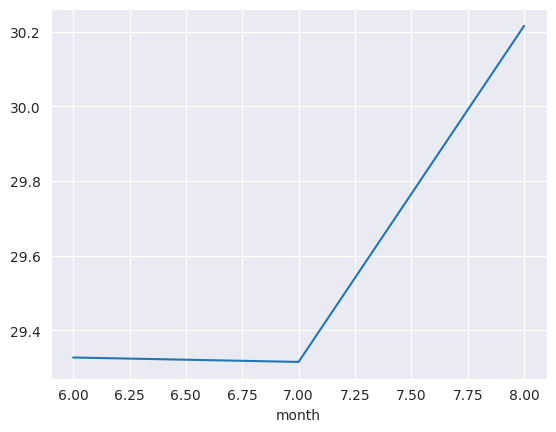

In [54]:
df.groupby(by='month')['Present_Tmax'].mean().plot.line()

<Axes: xlabel='month'>

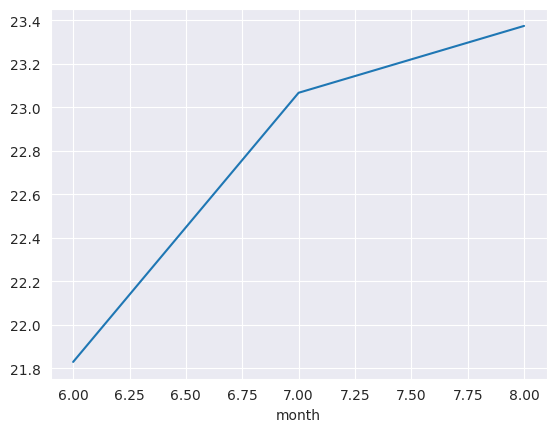

In [55]:
sns.set_style('darkgrid')
df.groupby(by='month')['Present_Tmin'].mean().plot.line()

<Axes: xlabel='year'>

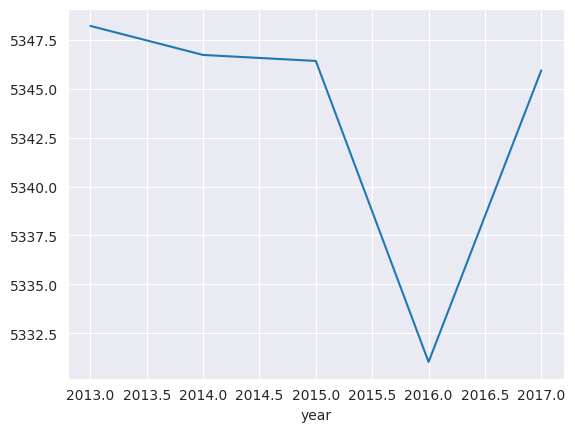

In [56]:
df.groupby(by='year')['Solar radiation'].mean().plot.line()

<Axes: xlabel='month'>

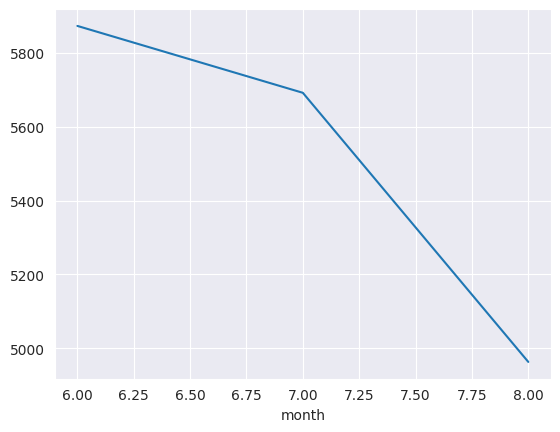

In [57]:
sns.set_style('darkgrid')
df.groupby(by='month')['Solar radiation'].mean().plot.line()

<Axes: xlabel='year'>

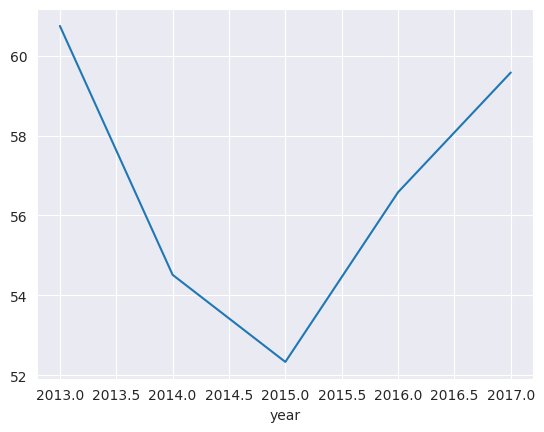

In [58]:
df.groupby(by='year')['LDAPS_RHmin'].mean().plot.line()

<Axes: xlabel='month'>

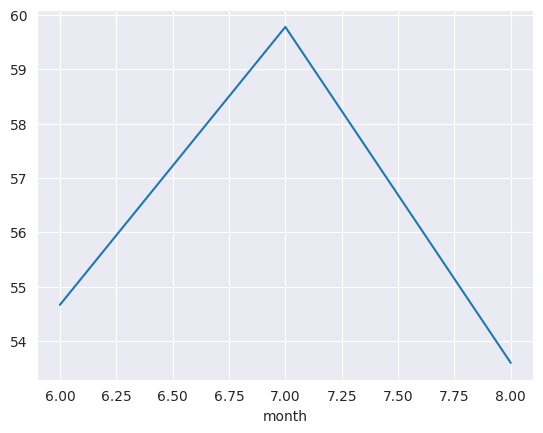

In [59]:
df.groupby(by='month')['LDAPS_RHmin'].mean().plot.line()

<Axes: xlabel='month'>

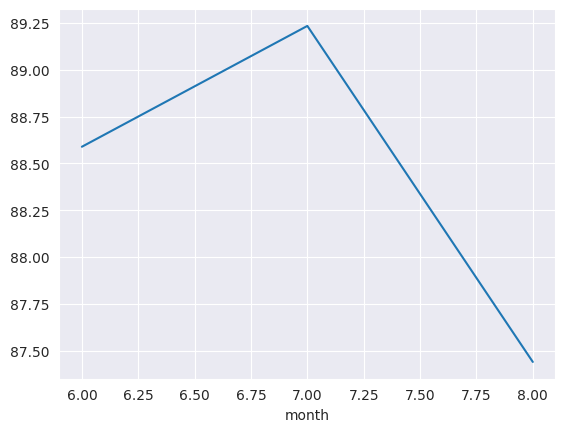

In [60]:
df.groupby(by='month')['LDAPS_RHmax'].mean().plot.line()

<Axes: xlabel='year'>

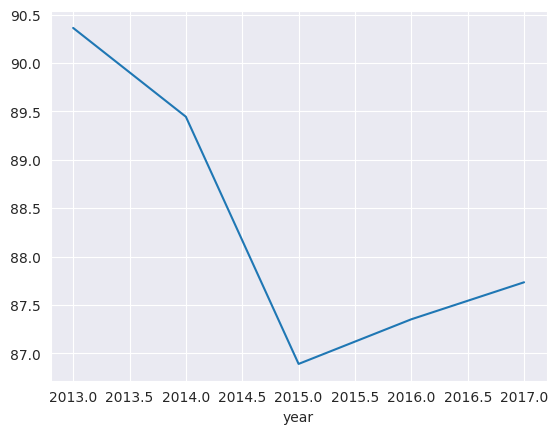

In [61]:
df.groupby(by='year')['LDAPS_RHmax'].mean().plot.line()

Text(0.5, 1.0, 'MEAN WIND SPEED BY YEAR')

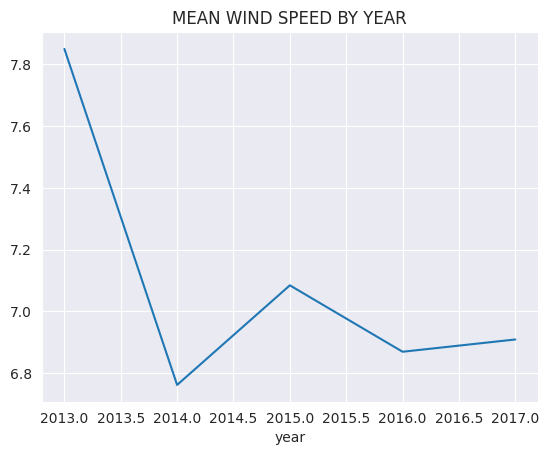

In [62]:
df.groupby(by='year')['LDAPS_WS'].mean().plot.line()
plt.title('MEAN WIND SPEED BY YEAR')

Text(0.5, 1.0, 'MEAN WIND SPEED BY MONTH')

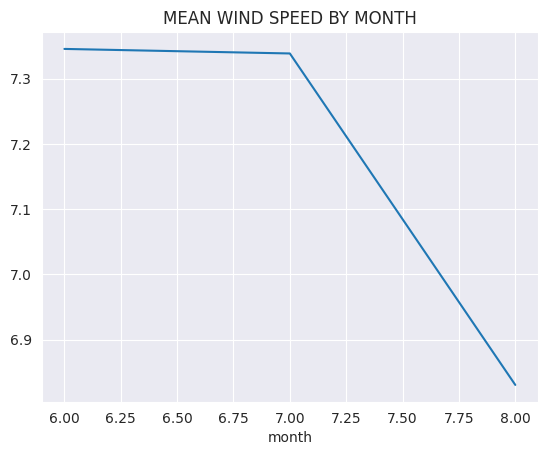

In [63]:
df.groupby(by='month')['LDAPS_WS'].mean().plot.line()
plt.title('MEAN WIND SPEED BY MONTH')

In [64]:
df.drop('Date', axis=1, inplace=True)
df
#We have dropped date as we created two new columns consisting of month and year

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year,month
0,1,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,...,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,2013,6
1,2,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,...,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,2013,6
2,3,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,...,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,2013,6
3,4,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,...,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,2013,6
4,5,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,...,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,2013,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,21,23.1,17.8,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,0.052902,...,0.0,37.5507,127.040,26.2980,0.5721,4456.024414,27.6,17.7,2017,8
7746,22,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,0.066461,...,0.0,37.5102,127.086,21.9668,0.1332,4441.803711,28.0,17.1,2017,8
7747,23,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,0.030034,...,0.0,37.5372,126.891,15.5876,0.1554,4443.313965,28.3,18.1,2017,8
7748,24,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,0.035874,...,0.0,37.5237,126.909,17.2956,0.2223,4438.373535,28.6,18.8,2017,8


<h2>DATA PREPROCESSING</h2>

In [65]:
from sklearn.preprocessing import StandardScaler

In [66]:
from sklearn.model_selection import train_test_split

In [67]:
#First model we will predict max next day temperarature.

In [68]:
X = df.drop(['Next_Tmax','Next_Tmin'], axis=1)
y =df['Next_Tmax']

<p style="font-size:120%;color:#4952ff">We will first try to predict maximum next day temparature. Hence, we have set the target variable y to next tmax.</p>

In [69]:
scaler = StandardScaler()

In [70]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [71]:
X_train.shape

(6070, 24)

In [72]:
X_test.shape

(1518, 24)

In [73]:
X_train

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,year,month
6642,18,30.1,25.5,63.743256,91.876495,30.193933,23.168006,5.577053,83.147026,0.141718,...,0.000000,0.000000,0.000000,37.4832,127.024,56.4448,1.2313,5689.926270,2017,7
7469,20,27.5,22.4,92.451935,99.208504,24.081100,21.254163,10.367878,35.139185,0.843557,...,0.671522,1.706064,0.065057,37.6181,127.004,146.5540,4.7296,4959.315430,2017,8
6936,12,28.2,23.7,58.318825,78.931541,30.642312,24.141183,7.237083,15.230229,0.387062,...,0.000000,0.000000,0.000000,37.5507,126.988,132.1180,0.5931,5524.085938,2017,7
2357,8,34.1,25.1,45.836838,77.601021,35.186408,26.809464,10.795521,84.852917,0.468707,...,0.000000,0.000000,0.590660,37.4697,126.910,52.5180,1.5629,5390.396484,2014,8
350,1,23.1,21.3,72.985626,98.905754,28.231726,22.614715,10.374683,54.318716,0.792033,...,0.874444,0.000000,0.000000,37.6046,126.991,212.3350,2.7850,5868.596680,2013,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5253,4,29.5,25.7,77.810013,99.226311,29.053216,25.451752,3.598260,63.197464,0.612539,...,0.002355,0.002979,0.000000,37.6450,127.022,45.7160,2.5348,5545.169922,2016,7
5288,14,32.0,26.2,50.294838,83.881470,32.217132,27.032874,8.874336,15.746239,0.218579,...,0.000000,0.000000,0.000000,37.4967,126.927,30.9680,0.6180,5524.800781,2016,7
5477,3,30.8,25.2,47.390812,92.908234,33.564936,24.197968,5.281015,68.499059,0.418305,...,0.000000,0.415253,0.524872,37.5776,127.058,33.3068,0.2661,5348.927246,2016,8
868,19,31.9,26.0,59.744675,88.695778,31.665128,25.518303,7.285725,45.637048,0.519194,...,0.000000,0.000000,0.000000,37.5776,126.938,75.0924,1.7678,5382.394043,2013,8


In [74]:
X_test

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,year,month
5226,2,29.7,25.5,85.654160,97.620262,27.288030,25.120174,7.084442,47.049533,0.869519,...,5.644295,1.073679,0.173957,37.6046,127.032,44.7624,0.5141,5578.307617,2016,7
6269,20,26.2,22.7,97.482574,99.999420,24.680362,22.575997,12.438663,-3.753933,0.940159,...,9.369441,0.020063,0.105110,37.6181,127.004,146.5540,4.7296,5921.158691,2017,7
1777,3,32.2,24.6,19.794666,93.002701,35.621577,24.539454,7.370578,34.704477,0.598355,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.2661,5794.317871,2014,7
1486,12,30.4,21.5,62.139370,89.064743,27.653973,24.139041,11.314960,39.058097,0.253035,...,0.038712,2.689160,0.000000,37.5507,126.988,132.1180,0.5931,4583.094727,2013,8
591,17,26.2,24.3,64.007744,95.123787,28.248261,23.526870,11.592773,115.990111,0.689040,...,0.105181,0.000000,0.000000,37.6181,127.099,53.4712,0.6970,5598.242676,2013,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1770,21,29.1,23.4,51.849541,88.949844,34.735942,25.359083,6.012421,79.429969,0.575489,...,0.000000,7.874809,0.601265,37.5507,127.040,26.2980,0.5721,5800.206543,2014,7
5499,25,31.7,23.0,47.944565,86.321388,33.895340,25.115679,6.209381,33.863699,0.360897,...,0.000000,0.000000,0.103245,37.5237,126.970,19.5844,0.2713,5340.794922,2016,8
3057,8,30.1,21.5,38.858658,84.011856,29.219554,21.011610,5.549288,57.412712,0.021188,...,0.000000,0.000000,0.000000,37.4697,126.910,52.5180,1.5629,4478.937012,2014,8
2661,12,25.6,20.9,63.164307,92.047333,24.604877,20.554550,4.480030,28.154223,0.651828,...,0.000000,0.000000,0.000000,37.5507,126.988,132.1180,0.5931,5117.001465,2014,8


In [75]:
y_train

6642    31.9
7469    25.3
6936    32.6
2357    35.3
350     26.1
        ... 
5253    31.9
5288    31.8
5477    34.1
868     31.3
7419    29.6
Name: Next_Tmax, Length: 6070, dtype: float64

In [76]:
y_test

5226    28.7
6269    27.8
1777    33.6
1486    25.5
591     29.4
        ... 
1770    32.5
5499    34.7
3057    30.0
2661    22.0
3289    25.9
Name: Next_Tmax, Length: 1518, dtype: float64

In [77]:
#Scaling the data

In [78]:
X_train = pd.DataFrame(scaler.fit_transform(X_train), columns=X_train.columns)
X_train

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,year,month
0,0.689491,0.117931,0.958798,0.482257,0.492324,0.192762,-0.145201,-0.698077,0.611880,-0.858728,...,-0.277109,-0.244099,-0.223639,-1.223093,0.407715,-0.106612,-0.024715,0.807267,1.413251,-0.883569
1,0.966419,-0.756443,-0.326975,2.446659,1.506210,-1.869786,-0.959944,1.475189,-0.807540,1.810895,...,0.107557,1.279675,-0.170072,1.455892,0.154940,1.543497,2.507058,-0.895503,1.413251,1.008903
2,-0.141292,-0.521035,0.212221,0.111088,-1.297733,0.344051,0.269090,0.054964,-1.396177,0.074501,...,-0.277109,-0.244099,-0.223639,0.117393,-0.047280,1.279140,-0.486590,0.420758,1.413251,-0.883569
3,-0.695148,1.463124,0.792892,-0.742996,-1.481721,1.877287,1.405004,1.669181,0.662317,0.385058,...,-0.277109,-0.244099,0.262706,-1.491190,-1.033101,-0.178520,0.215269,0.109179,-0.715217,1.008903
4,-1.664395,-2.236155,-0.783217,1.114669,1.464345,-0.469311,-0.380743,1.478276,-0.240470,1.614910,...,0.223796,-0.244099,-0.223639,1.187795,-0.009363,2.748100,1.099721,1.223678,-1.424706,-0.883569
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6065,-1.249004,-0.083847,1.041752,1.444780,1.508672,-0.192130,0.827013,-1.595718,0.022043,0.932160,...,-0.275759,-0.241438,-0.223639,1.990101,0.382437,-0.303081,0.918648,0.469896,0.703762,-0.883569
6066,0.135635,0.756898,1.249134,-0.437956,-0.613246,0.875416,1.500113,0.797672,-1.380920,-0.566367,...,-0.277109,-0.244099,-0.223639,-0.954996,-0.818242,-0.573151,-0.468570,0.422424,0.703762,-0.883569
6067,-1.387467,0.353340,0.834369,-0.636665,0.634995,1.330182,0.293264,-0.832369,0.178792,0.193340,...,-0.277109,0.126784,0.208536,0.651601,0.837432,-0.530322,-0.723245,0.012531,0.703762,1.008903
6068,0.827955,0.723268,1.166181,0.208652,0.052487,0.689162,0.855344,0.077029,-0.497156,0.577097,...,-0.277109,-0.244099,-0.223639,0.651601,-0.679216,0.234869,0.363558,0.090529,-1.424706,1.008903


In [79]:
X_test = pd.DataFrame(scaler.transform(X_test), columns=X_test.columns)
X_test

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,year,month
0,-1.525931,-0.016588,0.958798,1.981518,1.286584,-0.787726,0.685856,-0.014279,-0.455394,1.909647,...,2.956090,0.714859,-0.080404,1.187795,0.508825,-0.320544,-0.543764,0.547127,0.703762,-0.883569
1,0.966419,-1.193631,-0.202545,2.790882,1.615580,-1.667587,-0.397225,2.414560,-1.957470,2.178346,...,5.089950,-0.226180,-0.137092,1.455892,0.154940,1.543497,2.507058,1.346180,1.413251,-0.883569
2,-1.387467,0.824157,0.585510,-2.524942,0.648058,2.024119,0.438638,0.115521,-0.820393,0.878208,...,-0.277109,-0.244099,-0.223639,0.651601,0.837432,-0.530322,-0.723245,1.050563,-0.715217,-0.883569
3,-0.141292,0.218821,-0.700264,0.372510,0.103508,-0.664252,0.268178,1.904814,-0.691672,-0.435307,...,-0.254933,2.157728,-0.223639,0.117393,-0.047280,1.279140,-0.486590,-1.772328,-1.424706,1.008903
4,0.551027,-1.193631,0.461080,0.500354,0.941366,-0.463732,0.007571,2.030839,1.582933,1.223150,...,-0.216858,-0.244099,-0.223639,1.455892,1.355620,-0.161065,-0.411396,0.593588,-1.424706,-0.883569
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1513,1.104882,-0.218367,0.087791,-0.331575,0.087620,1.725294,0.787563,-0.500580,0.501980,0.791229,...,-0.277109,6.789298,0.271438,0.117393,0.609934,-0.658670,-0.501788,1.064288,-0.715217,-0.883569
1514,1.658738,0.656008,-0.078115,-0.598775,-0.275849,1.441664,0.683943,-0.411233,-0.845252,-0.025025,...,-0.277109,-0.244099,-0.138628,-0.418801,-0.274777,-0.781611,-0.719482,-0.006423,0.703762,1.008903
1515,-0.695148,0.117931,-0.700264,-1.220481,-0.595216,-0.136006,-1.063201,-0.710671,-0.148992,-1.317196,...,-0.277109,-0.244099,-0.223639,-1.491190,-1.033101,-0.178520,0.215269,-2.015079,-0.715217,1.008903
1516,-0.141292,-1.395410,-0.949123,0.442642,0.515947,-1.693057,-1.257776,-1.195720,-1.014060,1.081607,...,-0.277109,-0.244099,-0.223639,0.117393,-0.047280,1.279140,-0.486590,-0.527998,-0.715217,1.008903


<h2>MACHINE LEARNING MODEL TO PREDICT THE NEXT DAY MAX TEMP</h2>

<h3>LINEAR REGRESSION MODEL</h3>

In [80]:
from sklearn.linear_model import LinearRegression

In [81]:
lr = LinearRegression()

In [82]:
lr.fit(X_train, y_train)

LinearRegression()

In [83]:
lr_pred = lr.predict(X_test)
lr_pred

array([28.37369871, 26.11880882, 33.33574073, ..., 30.62553568,
       24.65603977, 29.14717378])

In [84]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

In [85]:
print(f'The mean absolute error (MAE) is {mean_absolute_error(y_test, lr_pred)}')
print()
print(f'The mean sqaured error (MSE) is {mean_squared_error(y_test, lr_pred)}')
print()
print(f'The root mean sqaured error (RMSE) is {np.sqrt(mean_squared_error(y_test, lr_pred))}')
print()
print(f'The R2 SCORE is {r2_score(y_test, lr_pred)}')

The mean absolute error (MAE) is 1.1054644314432063

The mean sqaured error (MSE) is 2.1305801574477203

The root mean sqaured error (RMSE) is 1.4596506970668428

The R2 SCORE is 0.7737629067951142


In [86]:
print('Training r2 score is',lr.score(X_train, y_train))

Training r2 score is 0.7854554102318644


<Axes: xlabel='Next_Tmax'>

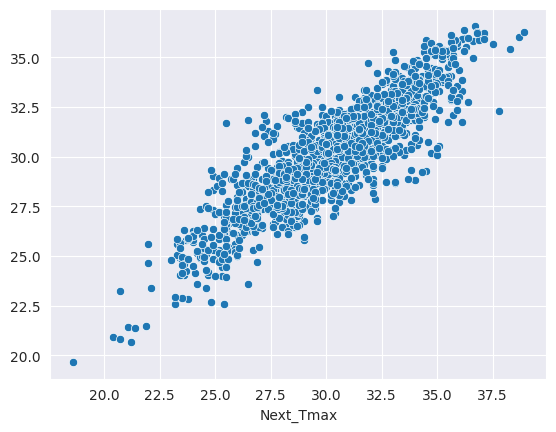

In [87]:
sns.scatterplot(x=y_test, y=lr_pred)

In [88]:
lr.coef_

array([ 1.35067624e-01,  4.36579202e-01, -7.52934655e-03,  3.27139020e-01,
        3.25642810e-02,  1.83745626e+00,  3.03326120e-01, -2.91151686e-01,
        2.42575569e-01, -3.27749131e-01, -1.76578784e-01, -1.94354503e-01,
       -3.17317418e-01, -1.13523947e-03,  2.35192882e-01, -5.05400334e-02,
       -1.15936730e-02, -4.81516731e-02, -1.34510210e-01, -2.44065313e-01,
        2.66658022e-01, -7.50355837e-02,  1.18826389e-01, -1.18355165e-01])

In [89]:
lr.fit_intercept

True

In [90]:
lr.rank_

24

<p style="font-size:140%;color:#ffb158">Our linear regression model is giving r2 score of 0.77 which is a really good score. Let's see if we can improve it by training some more models</p>

<h3>DECISION TREE MODEL</h3>

In [91]:
from sklearn.tree import DecisionTreeRegressor

In [92]:
dtr = DecisionTreeRegressor()

In [93]:
dtr.fit(X_train, y_train)

DecisionTreeRegressor()

In [94]:
dtr_pred = dtr.predict(X_test)
dtr_pred

array([29.2, 26.4, 33.8, ..., 29.9, 24. , 26.1])

In [95]:
print(f'The mean absolute error (MAE) is {mean_absolute_error(y_test, dtr_pred)}')
print()
print(f'The mean sqaured error (MSE) is {mean_squared_error(y_test, dtr_pred)}')
print()
print(f'The root mean sqaured error (RMSE) is {np.sqrt(mean_squared_error(y_test, dtr_pred))}')
print()
print(f'The R2 SCORE is {r2_score(y_test, dtr_pred)}')

The mean absolute error (MAE) is 1.0874176548089591

The mean sqaured error (MSE) is 2.309716732542819

The root mean sqaured error (RMSE) is 1.519775224348265

The R2 SCORE is 0.7547411685636164


In [96]:
print('Training r2 score is',dtr.score(X_train, y_train))

Training r2 score is 1.0


<Axes: xlabel='Next_Tmax'>

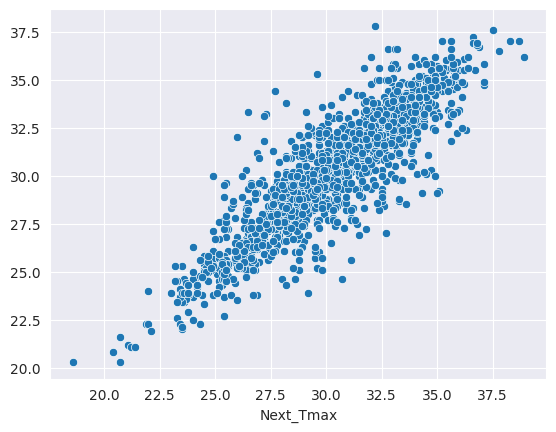

In [97]:
sns.scatterplot(x=y_test, y=dtr_pred)

<p style="font-size:120%;color:#ff53da">We are getting around the same r2 score however our training score is 1 which means our model is learning perfectly. There is no issue of overfitting and underfitting.</p>

<h3>RANDOM FOREST REGRESSOR MODEL</h3>

In [98]:
from sklearn.ensemble import RandomForestRegressor

In [99]:
rfr = RandomForestRegressor()

In [100]:
rfr.fit(X_train, y_train)

RandomForestRegressor()

In [101]:
rfr_pred = rfr.predict(X_test)
rfr_pred

array([29.025, 25.928, 33.438, ..., 30.106, 24.241, 27.417])

In [102]:
y_test

5226    28.7
6269    27.8
1777    33.6
1486    25.5
591     29.4
        ... 
1770    32.5
5499    34.7
3057    30.0
2661    22.0
3289    25.9
Name: Next_Tmax, Length: 1518, dtype: float64

In [103]:
print(f'The mean absolute error (MAE) is {mean_absolute_error(y_test, rfr_pred)}')
print()
print(f'The mean sqaured error (MSE) is {mean_squared_error(y_test, rfr_pred)}')
print()
print(f'The root mean sqaured error (RMSE) is {np.sqrt(mean_squared_error(y_test, rfr_pred))}')
print()
print(f'The R2 SCORE is {r2_score(y_test, rfr_pred)}')

The mean absolute error (MAE) is 0.7259907773386027

The mean sqaured error (MSE) is 0.9571423992094849

The root mean sqaured error (RMSE) is 0.9783365470069514

The R2 SCORE is 0.898365187799503


In [104]:
print('Training r2 score is',rfr.score(X_train, y_train))

Training r2 score is 0.9865805637292513


<Axes: xlabel='Next_Tmax'>

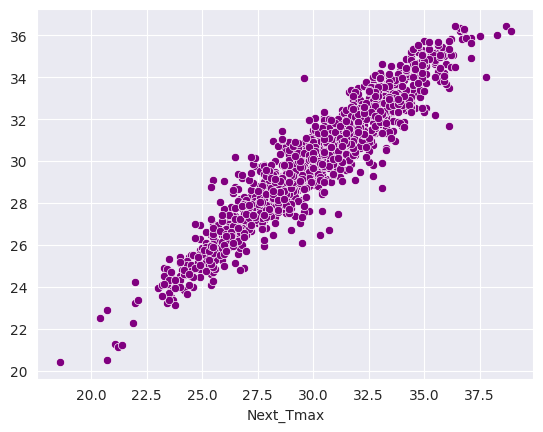

In [105]:
sns.scatterplot(x=y_test, y=rfr_pred, color='purple')

<p style="font-size:120%;color:#550000">Random Forest is a really good model. We are getting r2 score of 0.89 and training score is 0.98.This is almost a perfect model which doesn't have any bias or variance.</p>

<H3>SUPPORT VECTOR REGRESSION MODEL</H3>

In [106]:
from sklearn.svm import SVR

In [107]:
svr = SVR()

In [108]:
svr.fit(X_train, y_train)

SVR()

In [109]:
svr_pred = svr.predict(X_test)
svr_pred

array([28.95387352, 28.38767861, 32.56323031, ..., 30.10220742,
       23.39446058, 29.4617804 ])

In [110]:
print(f'The mean absolute error (MAE) is {mean_absolute_error(y_test, svr_pred)}')
print()
print(f'The mean sqaured error (MSE) is {mean_squared_error(y_test, svr_pred)}')
print()
print(f'The root mean sqaured error (RMSE) is {np.sqrt(mean_squared_error(y_test, svr_pred))}')
print()
print(f'The R2 SCORE is {r2_score(y_test, svr_pred)}')

The mean absolute error (MAE) is 0.8187102547132079

The mean sqaured error (MSE) is 1.2696737853728883

The root mean sqaured error (RMSE) is 1.126798023326669

The R2 SCORE is 0.8651788314478119


In [111]:
print('Training r2 score is',svr.score(X_train, y_train))

Training r2 score is 0.896442267986782


<Axes: xlabel='Next_Tmax'>

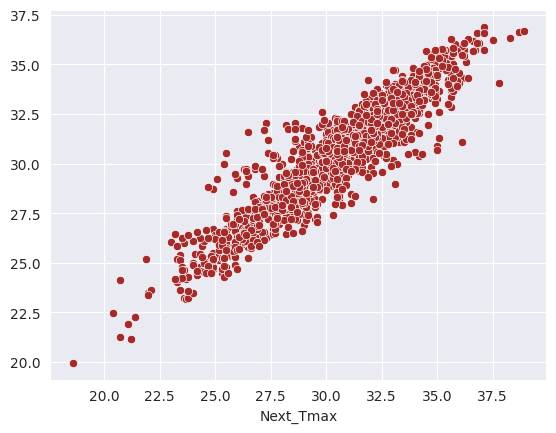

In [112]:
sns.scatterplot(x=y_test, y=svr_pred, color='brown')

<p style="font-size:140%;color:#090455">SVR is also a really good model similar to Random Forest but with marginal less score.</p>

<h3>KNN NEIGHBORS MODEL</h3>

In [113]:
from sklearn.neighbors import KNeighborsRegressor

In [114]:
knn = KNeighborsRegressor()

In [115]:
knn.fit(X_train,y_train)

KNeighborsRegressor()

In [116]:
knn_pred = knn.predict(X_test)
knn_pred

array([29.98, 28.54, 33.46, ..., 30.74, 24.4 , 27.26])

In [117]:
print(f'The mean absolute error (MAE) is {mean_absolute_error(y_test, knn_pred)}')
print()
print(f'The mean sqaured error (MSE) is {mean_squared_error(y_test, knn_pred)}')
print()
print(f'The root mean sqaured error (RMSE) is {np.sqrt(mean_squared_error(y_test, knn_pred))}')
print()
print(f'The R2 SCORE is {r2_score(y_test, knn_pred)}')

The mean absolute error (MAE) is 0.9140579710144927

The mean sqaured error (MSE) is 1.4955570487483534

The root mean sqaured error (RMSE) is 1.2229296990213105

The R2 SCORE is 0.8411932645443275


In [118]:
print('Training R2 SCORE IS', knn.score(X_train, y_train))

Training R2 SCORE IS 0.9116175580939615


<Axes: xlabel='Next_Tmax'>

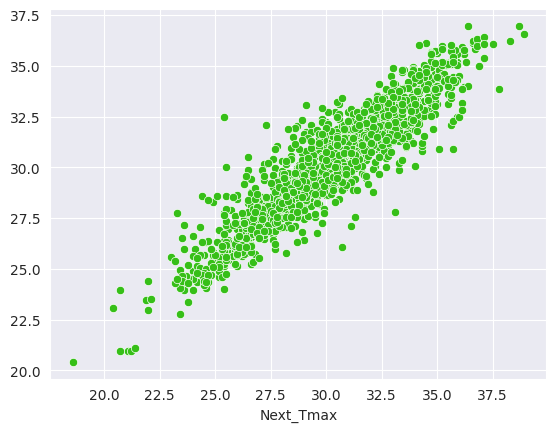

In [119]:
sns.scatterplot(x=y_test, y=knn_pred, color="#36bf18")

<p style="font-size:140%;color:#f10010">We can see that KNeighborsRegressor is a good model but below par as compared to SVR.</p>

<h3>XGBOOST model</h3>

In [120]:
from xgboost import XGBRegressor

In [121]:
xgb = XGBRegressor()

In [122]:
xgb.fit(X_train, y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [123]:
xgb_pred = xgb.predict(X_test)
xgb_pred

array([28.856392, 27.745388, 32.83323 , ..., 30.037775, 23.34818 ,
       27.064348], dtype=float32)

In [124]:
print(f'The mean absolute error (MAE) is {mean_absolute_error(y_test, xgb_pred)}')
print()
print(f'The mean sqaured error (MSE) is {mean_squared_error(y_test, xgb_pred)}')
print()
print(f'The root mean sqaured error (RMSE) is {np.sqrt(mean_squared_error(y_test, xgb_pred))}')
print()
print(f'The R2 SCORE is {r2_score(y_test, xgb_pred)}')

The mean absolute error (MAE) is 0.6430611850401787

The mean sqaured error (MSE) is 0.700768151661797

The root mean sqaured error (RMSE) is 0.8371189590863397

The R2 SCORE is 0.9255884604536802


In [125]:
print('Training r2 score is',xgb.score(X_train, y_train))

Training r2 score is 0.9917892532228857


<Axes: xlabel='Next_Tmax'>

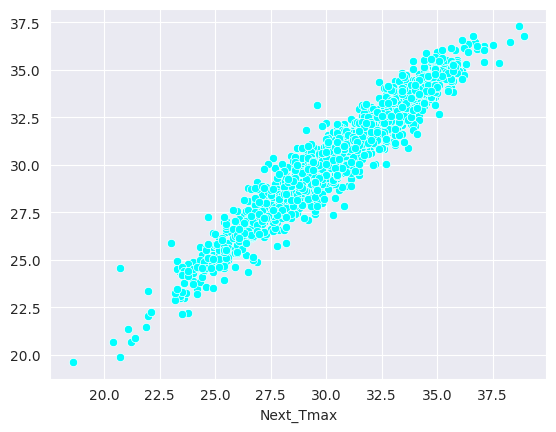

In [126]:
sns.scatterplot(x=y_test, y=xgb_pred, color='cyan')

<p style="font-size:120%;color:#4952ff">XTREME GRADIENT BOOSTING IS THE BEST MODEL WHICH GIVES AN R2 SCORE OF 0.92 AND THE MODEL IS ALMOST CLOSE TO PERFECTION.</p>
<p style="font-size:120%;color:#4952ff">HOWEVER, THERE IS ONE MORE MODEL WE WILL TEST AND THAT IS CATBOOST</p>

<h2>CATBOOST MODEL</h2>

In [127]:
from catboost import CatBoostRegressor

In [128]:
catboost = CatBoostRegressor()

In [129]:
catboost.fit(X_train, y_train)

Learning rate set to 0.054441
0:	learn: 3.0142061	total: 50.6ms	remaining: 50.6s
1:	learn: 2.9117602	total: 53.2ms	remaining: 26.6s
2:	learn: 2.8123741	total: 54.3ms	remaining: 18s
3:	learn: 2.7236484	total: 56ms	remaining: 13.9s
4:	learn: 2.6379430	total: 59.3ms	remaining: 11.8s
5:	learn: 2.5594370	total: 62.4ms	remaining: 10.3s
6:	learn: 2.4827683	total: 65.4ms	remaining: 9.28s
7:	learn: 2.4107201	total: 69ms	remaining: 8.56s
8:	learn: 2.3418578	total: 71.4ms	remaining: 7.86s
9:	learn: 2.2789340	total: 76ms	remaining: 7.52s
10:	learn: 2.2210611	total: 77.4ms	remaining: 6.96s
11:	learn: 2.1652933	total: 81ms	remaining: 6.67s
12:	learn: 2.1157649	total: 84.9ms	remaining: 6.44s
13:	learn: 2.0633203	total: 88ms	remaining: 6.2s
14:	learn: 2.0173292	total: 91.8ms	remaining: 6.03s
15:	learn: 1.9744106	total: 93.6ms	remaining: 5.75s
16:	learn: 1.9342250	total: 97.4ms	remaining: 5.63s
17:	learn: 1.8973638	total: 100ms	remaining: 5.45s
18:	learn: 1.8638556	total: 102ms	remaining: 5.28s
19:	lea

In [130]:
cat_pred = catboost.predict(X_test)
cat_pred

array([28.50825813, 27.44163746, 33.25979737, ..., 29.94068433,
       23.29852826, 26.3275899 ])

In [131]:
print(f'The mean absolute error (MAE) is {mean_absolute_error(y_test, cat_pred)}')
print()
print(f'The mean sqaured error (MSE) is {mean_squared_error(y_test, cat_pred)}')
print()
print(f'The root mean sqaured error (RMSE) is {np.sqrt(mean_squared_error(y_test, cat_pred))}')
print()
print(f'The R2 SCORE is {r2_score(y_test, cat_pred)}')

The mean absolute error (MAE) is 0.5565448718356577

The mean sqaured error (MSE) is 0.5212177778962085

The root mean sqaured error (RMSE) is 0.721954138360747

The R2 SCORE is 0.9446541381765209


In [132]:
print('Training r2 score is',catboost.score(X_train, y_train))

Training r2 score is 0.9800504802522246


<Axes: xlabel='Next_Tmax'>

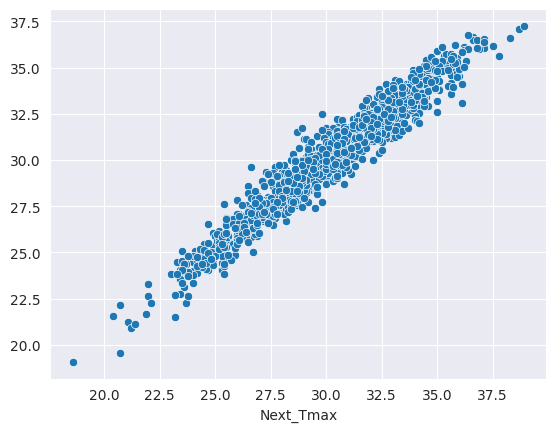

In [133]:
sns.scatterplot(x=y_test, y=cat_pred)

<p style="font-size:120%;color:#989413">CATBOOST IS THE BEST MODEL WHICH GIVES AN INSANE R2 SCORE OF 0.94 AND THERE IS NOT MUCH ROOM FOR IMPROVEMENT EVEN WITH CROSS VALIDATION AND HYPERPARAMTER TUNING BUT WE WILL STILL GIVE IT A SHOT.</p>

<H2>CROSS VALIDATION SCORE</H2>

In [134]:
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import GradientBoostingRegressor
np.random.seed(100)
def r2(model, X_train,y_train):
    r2 = cross_val_score(model, X_train,y_train, scoring='r2', cv=5)
    return(r2)


models = [LinearRegression(),
          SVR(),
          KNeighborsRegressor(),
          RandomForestRegressor(),
          DecisionTreeRegressor(),  
          GradientBoostingRegressor(),
          XGBRegressor(),
          CatBoostRegressor()]
            


names = ['LR','SVR','KNN','RFR','DTR','GBR', 'XGB', 'CAT']

for model,name in zip(models,names):
    score = r2(model,X_train,y_train)
    print("{}    : {:.6f}, {:4f}".format(name,score.mean(),score.std()))

LR    : 0.782766, 0.017028
SVR    : 0.865934, 0.015218
KNN    : 0.858773, 0.010467
RFR    : 0.896166, 0.008996
DTR    : 0.762959, 0.023614
GBR    : 0.858829, 0.010087
XGB    : 0.918952, 0.004466
Learning rate set to 0.052555
0:	learn: 3.0220114	total: 1.34ms	remaining: 1.34s
1:	learn: 2.9223185	total: 2.87ms	remaining: 1.43s
2:	learn: 2.8311526	total: 4.23ms	remaining: 1.41s
3:	learn: 2.7427614	total: 5.55ms	remaining: 1.38s
4:	learn: 2.6612156	total: 6.84ms	remaining: 1.36s
5:	learn: 2.5860659	total: 8.04ms	remaining: 1.33s
6:	learn: 2.5121882	total: 9.23ms	remaining: 1.31s
7:	learn: 2.4423899	total: 10.4ms	remaining: 1.29s
8:	learn: 2.3746498	total: 11.6ms	remaining: 1.28s
9:	learn: 2.3150909	total: 12.8ms	remaining: 1.26s
10:	learn: 2.2583579	total: 13.9ms	remaining: 1.25s
11:	learn: 2.2066545	total: 15ms	remaining: 1.23s
12:	learn: 2.1551342	total: 16ms	remaining: 1.21s
13:	learn: 2.1097843	total: 17ms	remaining: 1.2s
14:	learn: 2.0654457	total: 18ms	remaining: 1.18s
15:	learn: 2.0

In [135]:
#We see that there is no improvement in r2 score even after cross validation technique.

<H2>HYPERPARAMETER TUNING</H2>

In [136]:
from sklearn.model_selection import RandomizedSearchCV

In [141]:
param_grid = {
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7, 10],
    'min_child_weight': [1, 3, 5],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0],
    'n_estimators': [100, 200, 300],
    'objective': ['reg:squarederror']
}


In [142]:
randomized = RandomizedSearchCV(XGBRegressor(), param_distributions=param_grid, cv=5, n_jobs=-1, scoring='r2')

In [143]:
randomized.fit(X_train, y_train)

RandomizedSearchCV(cv=5,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          callbacks=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None, device=None,
                                          early_stopping_rounds=None,
                                          enable_categorical=False,
                                          eval_metric=None, feature_types=None,
                                          gamma=None, grow_policy=None,
                                          importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=...
                                          monotone_constraints=None,
                                          multi_strategy=None,
                                          n_estimators=None, n_jobs=None,
                                          num_parallel_tree=None,
                                          random_state=None, ...),
                   n_jobs=-1,
                   param_distributions={'colsample_bytree': [0.6, 0.8, 1.0],
                                        'learning_rate': [0.01, 0.1, 0.2],
                                        'max_depth': [3, 5, 7, 10],
                                        'min_child_weight': [1, 3, 5],
                                        'n_estimators': [100, 200, 300],
                                        'objective': ['reg:squarederror'],
                                        'subsample': [0.6, 0.8, 1.0]},
                   scoring='r2')

In [144]:
randomized.best_score_

0.9305192615052276

In [145]:
randomized.best_params_

{'subsample': 0.8,
 'objective': 'reg:squarederror',
 'n_estimators': 200,
 'min_child_weight': 1,
 'max_depth': 7,
 'learning_rate': 0.1,
 'colsample_bytree': 0.8}

In [146]:
randomized.best_estimator_

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.8, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=7, max_leaves=None,
             min_child_weight=1, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=200, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

<p style="font-size:120%;color:#ff5500">It is best to use the CatBoostRegressor model as it gives high r2 score and doesnt have the problem of overfitting and ubderfitting as well it gives low errors. So, we will now save the model which we created for predicting the next day maximum temperature</p>

<h2>SAVING THE MODEL</h2>

In [147]:
import joblib

In [148]:
joblib.dump(catboost, 'CatBoost_NextTMax.pkl')

['CatBoost_NextTMax.pkl']

In [150]:
#********************************************************************************************8

<h2>MACHINE LEARNING MODEL TO PREDICT THE NEXT DAY MINIMUM TEMPERATURE

In [151]:
#We need to change only y or target variable and then do train test split and then scale the data

<h3>DATA PREPROCESSING</h3>

In [152]:
y = df['Next_Tmin']

In [153]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [154]:
X_train.shape

(6070, 24)

In [155]:
X_test.shape

(1518, 24)

In [156]:
scaler = StandardScaler()

In [157]:
X_train = pd.DataFrame(scaler.fit_transform(X_train), columns=X_train.columns)
X_train

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,year,month
0,0.689491,0.117931,0.958798,0.482257,0.492324,0.192762,-0.145201,-0.698077,0.611880,-0.858728,...,-0.277109,-0.244099,-0.223639,-1.223093,0.407715,-0.106612,-0.024715,0.807267,1.413251,-0.883569
1,0.966419,-0.756443,-0.326975,2.446659,1.506210,-1.869786,-0.959944,1.475189,-0.807540,1.810895,...,0.107557,1.279675,-0.170072,1.455892,0.154940,1.543497,2.507058,-0.895503,1.413251,1.008903
2,-0.141292,-0.521035,0.212221,0.111088,-1.297733,0.344051,0.269090,0.054964,-1.396177,0.074501,...,-0.277109,-0.244099,-0.223639,0.117393,-0.047280,1.279140,-0.486590,0.420758,1.413251,-0.883569
3,-0.695148,1.463124,0.792892,-0.742996,-1.481721,1.877287,1.405004,1.669181,0.662317,0.385058,...,-0.277109,-0.244099,0.262706,-1.491190,-1.033101,-0.178520,0.215269,0.109179,-0.715217,1.008903
4,-1.664395,-2.236155,-0.783217,1.114669,1.464345,-0.469311,-0.380743,1.478276,-0.240470,1.614910,...,0.223796,-0.244099,-0.223639,1.187795,-0.009363,2.748100,1.099721,1.223678,-1.424706,-0.883569
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6065,-1.249004,-0.083847,1.041752,1.444780,1.508672,-0.192130,0.827013,-1.595718,0.022043,0.932160,...,-0.275759,-0.241438,-0.223639,1.990101,0.382437,-0.303081,0.918648,0.469896,0.703762,-0.883569
6066,0.135635,0.756898,1.249134,-0.437956,-0.613246,0.875416,1.500113,0.797672,-1.380920,-0.566367,...,-0.277109,-0.244099,-0.223639,-0.954996,-0.818242,-0.573151,-0.468570,0.422424,0.703762,-0.883569
6067,-1.387467,0.353340,0.834369,-0.636665,0.634995,1.330182,0.293264,-0.832369,0.178792,0.193340,...,-0.277109,0.126784,0.208536,0.651601,0.837432,-0.530322,-0.723245,0.012531,0.703762,1.008903
6068,0.827955,0.723268,1.166181,0.208652,0.052487,0.689162,0.855344,0.077029,-0.497156,0.577097,...,-0.277109,-0.244099,-0.223639,0.651601,-0.679216,0.234869,0.363558,0.090529,-1.424706,1.008903


In [158]:
X_test = pd.DataFrame(scaler.transform(X_test), columns=X_test.columns)
X_test

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,year,month
0,-1.525931,-0.016588,0.958798,1.981518,1.286584,-0.787726,0.685856,-0.014279,-0.455394,1.909647,...,2.956090,0.714859,-0.080404,1.187795,0.508825,-0.320544,-0.543764,0.547127,0.703762,-0.883569
1,0.966419,-1.193631,-0.202545,2.790882,1.615580,-1.667587,-0.397225,2.414560,-1.957470,2.178346,...,5.089950,-0.226180,-0.137092,1.455892,0.154940,1.543497,2.507058,1.346180,1.413251,-0.883569
2,-1.387467,0.824157,0.585510,-2.524942,0.648058,2.024119,0.438638,0.115521,-0.820393,0.878208,...,-0.277109,-0.244099,-0.223639,0.651601,0.837432,-0.530322,-0.723245,1.050563,-0.715217,-0.883569
3,-0.141292,0.218821,-0.700264,0.372510,0.103508,-0.664252,0.268178,1.904814,-0.691672,-0.435307,...,-0.254933,2.157728,-0.223639,0.117393,-0.047280,1.279140,-0.486590,-1.772328,-1.424706,1.008903
4,0.551027,-1.193631,0.461080,0.500354,0.941366,-0.463732,0.007571,2.030839,1.582933,1.223150,...,-0.216858,-0.244099,-0.223639,1.455892,1.355620,-0.161065,-0.411396,0.593588,-1.424706,-0.883569
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1513,1.104882,-0.218367,0.087791,-0.331575,0.087620,1.725294,0.787563,-0.500580,0.501980,0.791229,...,-0.277109,6.789298,0.271438,0.117393,0.609934,-0.658670,-0.501788,1.064288,-0.715217,-0.883569
1514,1.658738,0.656008,-0.078115,-0.598775,-0.275849,1.441664,0.683943,-0.411233,-0.845252,-0.025025,...,-0.277109,-0.244099,-0.138628,-0.418801,-0.274777,-0.781611,-0.719482,-0.006423,0.703762,1.008903
1515,-0.695148,0.117931,-0.700264,-1.220481,-0.595216,-0.136006,-1.063201,-0.710671,-0.148992,-1.317196,...,-0.277109,-0.244099,-0.223639,-1.491190,-1.033101,-0.178520,0.215269,-2.015079,-0.715217,1.008903
1516,-0.141292,-1.395410,-0.949123,0.442642,0.515947,-1.693057,-1.257776,-1.195720,-1.014060,1.081607,...,-0.277109,-0.244099,-0.223639,0.117393,-0.047280,1.279140,-0.486590,-0.527998,-0.715217,1.008903


In [159]:
#We are ready for training the second model

<h2>LINEAR REGRESSION MODEL</h2>

In [160]:
lr = LinearRegression()

In [161]:
lr.fit(X_train, y_train)

LinearRegression()

In [162]:
lr_pred = lr.predict(X_test)
lr_pred

array([24.36454498, 21.79442597, 23.56903115, ..., 20.93105785,
       19.14041836, 22.45522576])

In [163]:
y_test

5226    24.5
6269    21.5
1777    24.7
1486    22.5
591     23.3
        ... 
1770    24.9
5499    24.7
3057    21.0
2661    19.3
3289    20.1
Name: Next_Tmin, Length: 1518, dtype: float64

In [164]:
print(f'The mean absolute error (MAE) is {mean_absolute_error(y_test, lr_pred)}')
print()
print(f'The mean sqaured error (MSE) is {mean_squared_error(y_test, lr_pred)}')
print()
print(f'The root mean sqaured error (RMSE) is {np.sqrt(mean_squared_error(y_test, lr_pred))}')
print()
print(f'The R2 SCORE is {r2_score(y_test, lr_pred)}')

The mean absolute error (MAE) is 0.7879813799989424

The mean sqaured error (MSE) is 1.0244098896081812

The root mean sqaured error (RMSE) is 1.0121313598580874

The R2 SCORE is 0.8332444500753863


In [165]:
print('Training r2 score is',lr.score(X_train, y_train))

Training r2 score is 0.8367993473368527


<Axes: xlabel='Next_Tmin'>

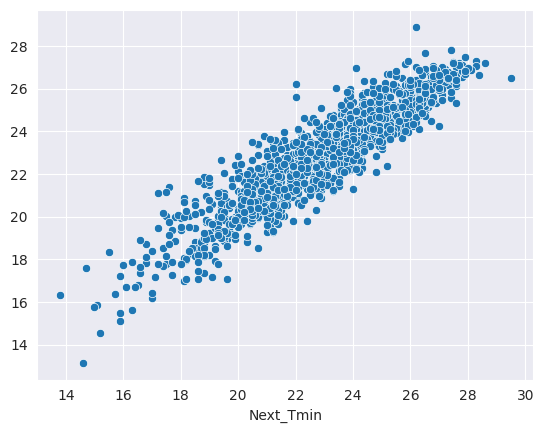

In [166]:
sns.scatterplot(x=y_test, y=lr_pred)

<p style="font-size:120%;color:#4952ff">Linear Regression model is giving good results like r2 score is 0.83 and there is zero chance of overfitting and underfitting.</p>

<h3>SVM REGRESSION_MODEL</h3>

In [167]:
svr = SVR()

In [168]:
svr.fit(X_train, y_train)

SVR()

In [169]:
svr_pred = svr.predict(X_test)
svr_pred

array([25.05557416, 21.95555969, 22.86793306, ..., 20.46670183,
       19.29695402, 21.52086381])

In [170]:
print(f'The mean absolute error (MAE) is {mean_absolute_error(y_test, svr_pred)}')
print()
print(f'The mean sqaured error (MSE) is {mean_squared_error(y_test, svr_pred)}')
print()
print(f'The root mean sqaured error (RMSE) is {np.sqrt(mean_squared_error(y_test, svr_pred))}')
print()
print(f'The R2 SCORE is {r2_score(y_test,svr_pred)}')

The mean absolute error (MAE) is 0.597479043136503

The mean sqaured error (MSE) is 0.6229797401254877

The root mean sqaured error (RMSE) is 0.7892906563019023

The R2 SCORE is 0.8985900758960332


In [171]:
print('Training r2 score is',svr.score(X_train, y_train))

Training r2 score is 0.9249481511242708


<Axes: xlabel='Next_Tmin'>

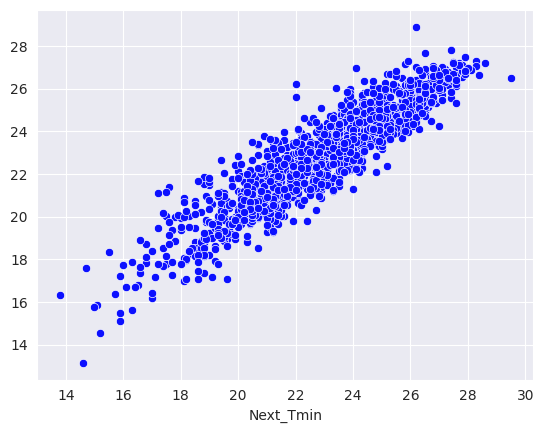

In [172]:
sns.scatterplot(x=y_test, y=lr_pred, color="#0c10ff")

<p style="font-size:120%;color:#0a9a2b">SVR MODEL IS GIVING R2 SCORE OF 0.89 WHICH IS AN IMPROVEMENT OVER LINEAR REGRESSION MODEL AND OUR MODEL IS FITTING THE DATA VERY WELL. HOWEVER, THERE IS A HUGE CHANCE OF GETTING BETTER SCORE FROM THE NEXT FEW MODELS.--</p>

<H3>RANDOM FOREST MODEL</H3>

In [173]:
rfr = RandomForestRegressor()

In [174]:
rfr.fit(X_train, y_train)

RandomForestRegressor()

In [176]:
rfr_pred = rfr.predict(X_test)
rfr_pred

array([24.872, 21.971, 23.864, ..., 20.746, 20.077, 22.311])

In [177]:
y_test

5226    24.5
6269    21.5
1777    24.7
1486    22.5
591     23.3
        ... 
1770    24.9
5499    24.7
3057    21.0
2661    19.3
3289    20.1
Name: Next_Tmin, Length: 1518, dtype: float64

In [178]:
print(f'The mean absolute error (MAE) is {mean_absolute_error(y_test, rfr_pred)}')
print()
print(f'The mean sqaured error (MSE) is {mean_squared_error(y_test, rfr_pred)}')
print()
print(f'The root mean sqaured error (RMSE) is {np.sqrt(mean_squared_error(y_test, rfr_pred))}')
print()
print(f'The R2 SCORE is {r2_score(y_test, rfr_pred)}')

The mean absolute error (MAE) is 0.5854295125164688

The mean sqaured error (MSE) is 0.6044245125164689

The root mean sqaured error (RMSE) is 0.7774474339249368

The R2 SCORE is 0.9016105340303273


In [179]:
print('Training r2 score is',rfr.score(X_train, y_train))

Training r2 score is 0.9865477191306031


<Axes: xlabel='Next_Tmin'>

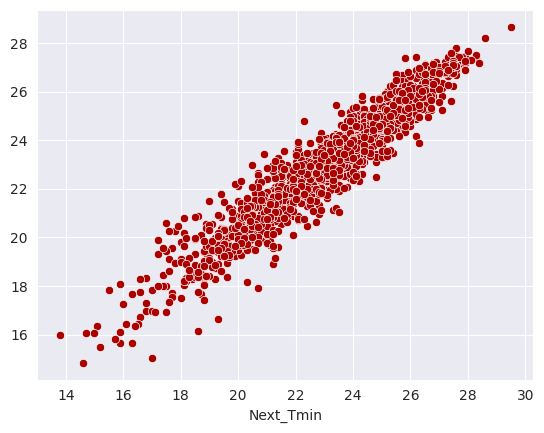

In [180]:
sns.scatterplot(x=y_test, y=rfr_pred, color="#aa0000")

<p style="font-size:120%;color:#00557f">We don't see much improvement over SVM MODEL. Lets try some other model.</p>

<h3>XGBOOST MODEL</h3>

In [182]:
xgb = XGBRegressor()

In [183]:
xgb.fit(X_train, y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [184]:
xgb_pred = xgb.predict(X_test)
xgb_pred

array([24.500998, 22.03848 , 24.272442, ..., 20.730558, 19.439884,
       21.309515], dtype=float32)

In [185]:
print(f'The mean absolute error (MAE) is {mean_absolute_error(y_test, xgb_pred)}')
print()
print(f'The mean sqaured error (MSE) is {mean_squared_error(y_test, xgb_pred)}')
print()
print(f'The root mean sqaured error (RMSE) is {np.sqrt(mean_squared_error(y_test, xgb_pred))}')
print()
print(f'The R2 SCORE is {r2_score(y_test, xgb_pred)}')

The mean absolute error (MAE) is 0.47342535830612087

The mean sqaured error (MSE) is 0.38062044272107853

The root mean sqaured error (RMSE) is 0.6169444405463741

The R2 SCORE is 0.9380418210695137


In [186]:
print('Training r2 score is',xgb.score(X_train, y_train))

Training r2 score is 0.9928564428760182


<Axes: xlabel='Next_Tmin'>

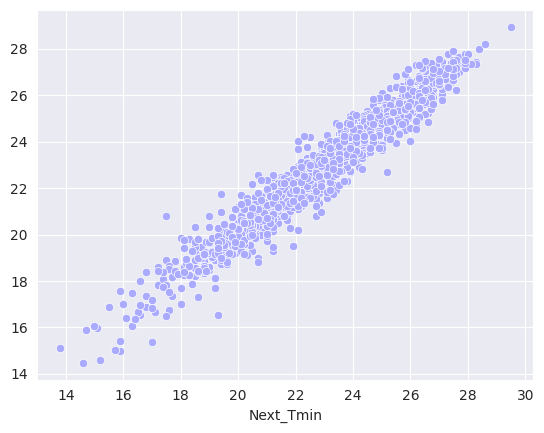

In [187]:
sns.scatterplot(x=y_test, y=xgb_pred, color="#aaaaff")

In [189]:
#XTREME GRADIENT BOOSTING IS THE BEST MODEL AS IT GIVES AN R2 SCORE OF 0.93 WHICH IS FANTASTIC FOR US. 
#We only choosed those models to train which we were confident that will only increase based on our 
#--------previous model training of predicting maximum temperature.
#There is one more roll of a dice of CatBoost.

<h3>CATBOOST MODEL</h3

In [190]:
cat = CatBoostRegressor()

In [191]:
cat.fit(X_train, y_train)

Learning rate set to 0.054441
0:	learn: 2.3886063	total: 3.77ms	remaining: 3.76s
1:	learn: 2.2983289	total: 7.55ms	remaining: 3.77s
2:	learn: 2.2139933	total: 10.8ms	remaining: 3.58s
3:	learn: 2.1314832	total: 14.1ms	remaining: 3.5s
4:	learn: 2.0552231	total: 17.1ms	remaining: 3.4s
5:	learn: 1.9860743	total: 20.3ms	remaining: 3.36s
6:	learn: 1.9168497	total: 23.3ms	remaining: 3.31s
7:	learn: 1.8529729	total: 26ms	remaining: 3.22s
8:	learn: 1.7950097	total: 28.8ms	remaining: 3.17s
9:	learn: 1.7398640	total: 32.6ms	remaining: 3.22s
10:	learn: 1.6885121	total: 35.6ms	remaining: 3.2s
11:	learn: 1.6398029	total: 39.1ms	remaining: 3.22s
12:	learn: 1.5944496	total: 42.6ms	remaining: 3.23s
13:	learn: 1.5542528	total: 46.6ms	remaining: 3.28s
14:	learn: 1.5159272	total: 50.2ms	remaining: 3.29s
15:	learn: 1.4780547	total: 53.6ms	remaining: 3.3s
16:	learn: 1.4448126	total: 59.3ms	remaining: 3.43s
17:	learn: 1.4124044	total: 60.8ms	remaining: 3.32s
18:	learn: 1.3811224	total: 63.9ms	remaining: 3.3s

In [192]:
cat_pred = cat.predict(X_test)
cat_pred

array([24.64957126, 22.14625809, 24.06716126, ..., 20.83838031,
       19.42224858, 20.67743687])

In [193]:
print(f'The mean absolute error (MAE) is {mean_absolute_error(y_test, cat_pred)}')
print()
print(f'The mean sqaured error (MSE) is {mean_squared_error(y_test, cat_pred)}')
print()
print(f'The root mean sqaured error (RMSE) is {np.sqrt(mean_squared_error(y_test, cat_pred))}')
print()
print(f'The R2 SCORE is {r2_score(y_test, cat_pred)}')

The mean absolute error (MAE) is 0.415816662395931

The mean sqaured error (MSE) is 0.29255312736514955

The root mean sqaured error (RMSE) is 0.540881805355985

The R2 SCORE is 0.9523775998935344


In [194]:
print('Training r2 score is',cat.score(X_train, y_train))

Training r2 score is 0.982218124804165


<Axes: xlabel='Next_Tmin'>

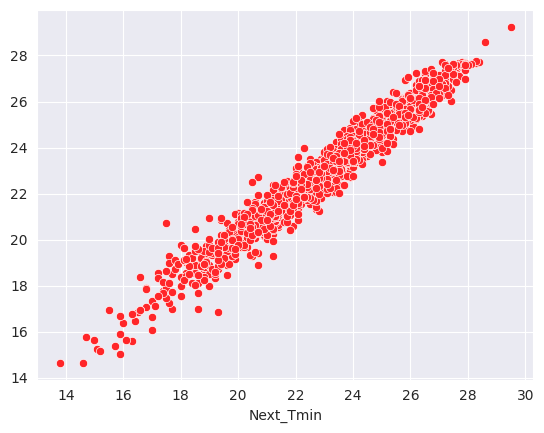

In [195]:
sns.scatterplot(x=y_test, y=cat_pred, color="#ff2629")

<p style="font-size:120%;color:#00007f">We see that our r2 score is 0.95 which was given by CatBoost model and I don't think we can go beyond that but we will try cross validation and hyperparameter tuning just to verify our model.</p>

<h2>CROSS VALIDATION TECHNIQUE</h2>

In [196]:
from sklearn.model_selection import cross_val_score

np.random.seed(100)
def r2(model, X_train,y_train):
    r2 = cross_val_score(model, X_train,y_train, scoring='r2', cv=5)
    return(r2)


models = [LinearRegression(),
          SVR(),
          KNeighborsRegressor(),
          RandomForestRegressor(),
          DecisionTreeRegressor(),  
          GradientBoostingRegressor(),
          XGBRegressor(),
          CatBoostRegressor()]
            


names = ['LR','SVR','KNN','RFR','DTR','GBR', 'XGB', 'CAT']

for model,name in zip(models,names):
    score = r2(model,X_train,y_train)
    print("{}    : {:.6f}, {:4f}".format(name,score.mean(),score.std()))

LR    : 0.835516, 0.004048
SVR    : 0.896012, 0.007039
KNN    : 0.861289, 0.006581
RFR    : 0.901474, 0.005009
DTR    : 0.776223, 0.011088
GBR    : 0.887062, 0.003756
XGB    : 0.930320, 0.001519
Learning rate set to 0.052555
0:	learn: 2.4001052	total: 3.36ms	remaining: 3.36s
1:	learn: 2.3121730	total: 7.21ms	remaining: 3.6s
2:	learn: 2.2322622	total: 10.8ms	remaining: 3.59s
3:	learn: 2.1532056	total: 14.2ms	remaining: 3.54s
4:	learn: 2.0787832	total: 18.2ms	remaining: 3.61s
5:	learn: 2.0109981	total: 23.1ms	remaining: 3.82s
6:	learn: 1.9432804	total: 27.4ms	remaining: 3.88s
7:	learn: 1.8791266	total: 30.5ms	remaining: 3.78s
8:	learn: 1.8212348	total: 33.9ms	remaining: 3.73s
9:	learn: 1.7691420	total: 36.8ms	remaining: 3.65s
10:	learn: 1.7175991	total: 39.9ms	remaining: 3.58s
11:	learn: 1.6700979	total: 43.1ms	remaining: 3.55s
12:	learn: 1.6258703	total: 46.4ms	remaining: 3.52s
13:	learn: 1.5853390	total: 50ms	remaining: 3.52s
14:	learn: 1.5479254	total: 53.1ms	remaining: 3.49s
15:	lear

<h2>HYPERPARAMETER TUNING</h2>

In [198]:
from sklearn.model_selection import RandomizedSearchCV

In [199]:
param_grid = {
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7, 10],
    'min_child_weight': [1, 3, 5],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0],
    'n_estimators': [100, 200, 300],
    'objective': ['reg:squarederror']
}


In [200]:
random = RandomizedSearchCV(XGBRegressor(), param_grid, cv=5, n_jobs=-1, scoring='r2', verbose=1)

In [201]:
random.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          callbacks=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None, device=None,
                                          early_stopping_rounds=None,
                                          enable_categorical=False,
                                          eval_metric=None, feature_types=None,
                                          gamma=None, grow_policy=None,
                                          importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=...
                                          multi_strategy=None,
                                          n_estimators=None, n_jobs=None,
                                          num_parallel_tree=None,
                                          random_state=None, ...),
                   n_jobs=-1,
                   param_distributions={'colsample_bytree': [0.6, 0.8, 1.0],
                                        'learning_rate': [0.01, 0.1, 0.2],
                                        'max_depth': [3, 5, 7, 10],
                                        'min_child_weight': [1, 3, 5],
                                        'n_estimators': [100, 200, 300],
                                        'objective': ['reg:squarederror'],
                                        'subsample': [0.6, 0.8, 1.0]},
                   scoring='r2', verbose=1)

In [202]:
random.best_score_

0.9390836853587168

In [203]:
random.best_params_

{'subsample': 0.8,
 'objective': 'reg:squarederror',
 'n_estimators': 300,
 'min_child_weight': 1,
 'max_depth': 5,
 'learning_rate': 0.1,
 'colsample_bytree': 0.8}

In [204]:
#Our model is not improving much even after hyperparameter tuning. So, we will stop here and save this model too
#like we did with our previos model.
#This model will predict the next day minimum temperature.

<h3>SAVING THE SECOND MODEL WHICH PREDICTS THE NEXT DAY MINIMUM TEMPERATURE</h3>

In [205]:
joblib.dump(cat, 'CatBoost_NextTMin.pkl')

['CatBoost_NextTMin.pkl']

In [206]:
#We have successfully saved both the models to predict the next day max and min temperatures respectively
#and completed the project.

<h1>DOCUMENTATION</h1>

<p style="font-size:120%;color:#6a0c6a">We first built a machine learning model to find the next day maximum temperature based on various features like cloud cover, precipitation, solar radiation, etc and the best perfroming model was CatBoost model which gave an insane score of 0.94.</p>

<p style="font-size:120%;color:#ec970d">Some metrics have been shown below ⬇️</p>

In [2]:
from IPython.display import Image

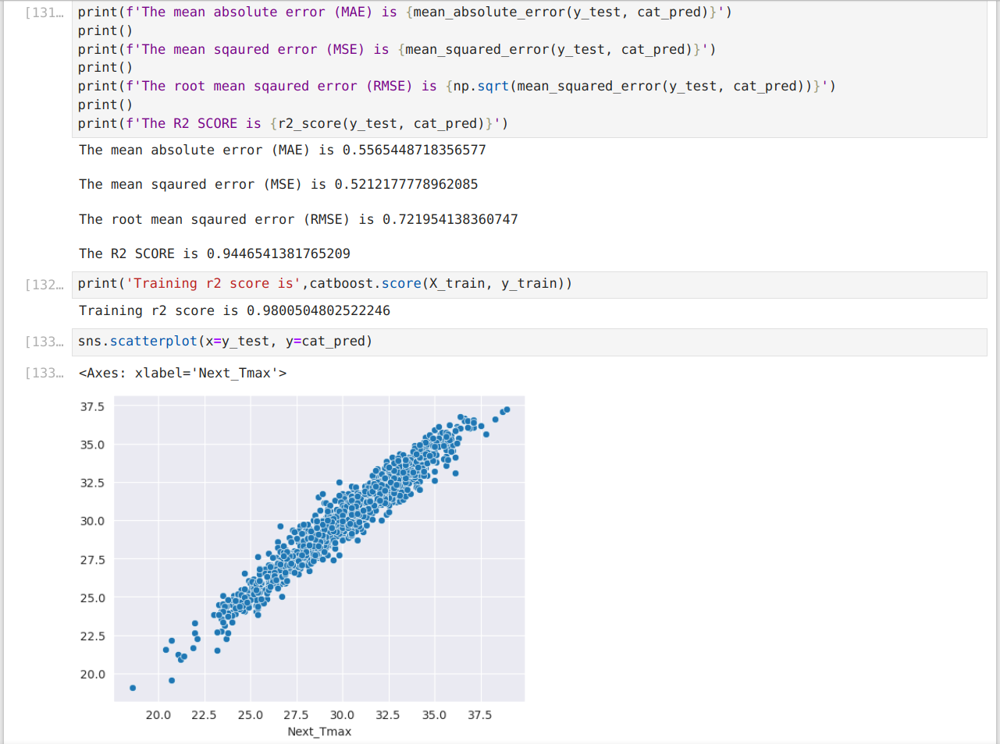

In [3]:
Image(filename='Screenshot_20240711_150318.png')

<p style="font-size:120%;color:#9e699e">Next, we build the second model for predicting the next day minimum temperature
the model was also giving an insane accuracy of 0.95 and that algorithm was none other than CatBoost. So, for predicting both the max and min temperature we used
category boosting model.</p>
<p style="font-size:120%;color:#33959e">Some metrics are given below ⬇️</p>

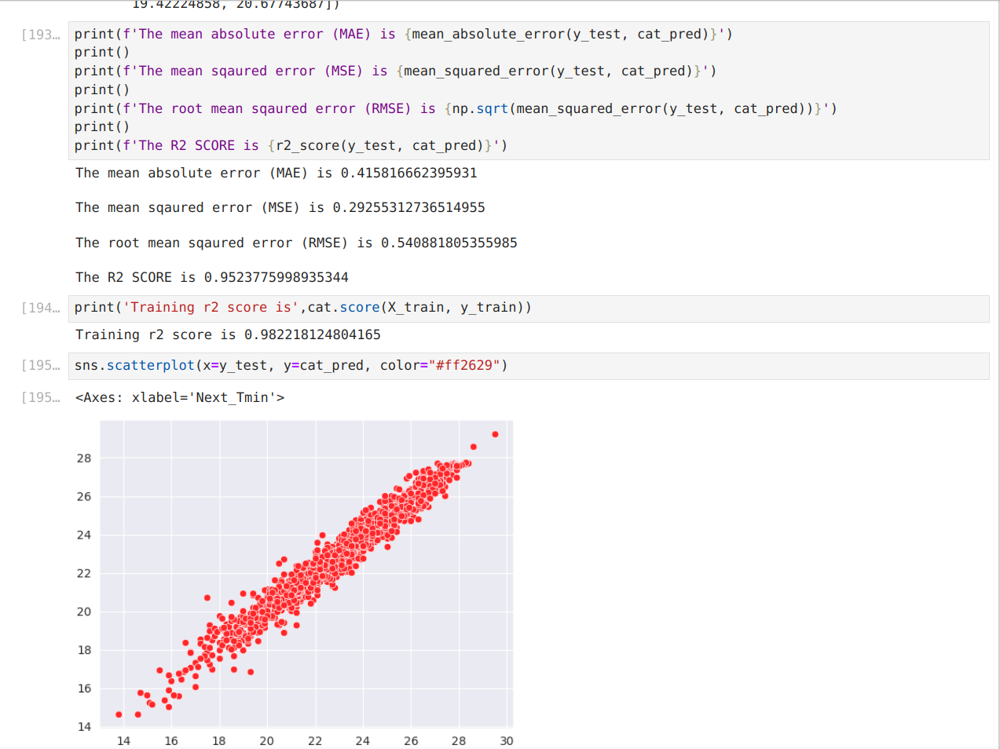

In [4]:
Image(filename='Screenshot_20240711_150420.png')

<h1>THANK YOU</h1>

In [5]:
#*********************************************************************************************8